# Descarga de dataset

In [58]:
import gdown
import zipfile
import os

import numpy as np
import pandas as pd

import cv2
import matplotlib.pyplot as plt

!pip install ultralytics
from ultralytics import YOLO

import random
random.seed(123)

In [59]:
# Descargar el archivo desde Google Drive
file_id_train = '1Vp9yMIzC9cokrEKEoc-B3dmPLWwGTNTw' #https://drive.google.com/file/d/1Vp9yMIzC9cokrEKEoc-B3dmPLWwGTNTw/view?usp=drive_link
gdown.download(f'https://drive.google.com/uc?id={file_id_train}', 'VisDrone2019-DET-train.zip', quiet=False)

# Descomprimir el archivo
with zipfile.ZipFile("VisDrone2019-DET-train.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")

# Eliminar el archivo zip después de la extracción
os.remove("VisDrone2019-DET-train.zip")


Downloading...
From (original): https://drive.google.com/uc?id=1Vp9yMIzC9cokrEKEoc-B3dmPLWwGTNTw
From (redirected): https://drive.google.com/uc?id=1Vp9yMIzC9cokrEKEoc-B3dmPLWwGTNTw&confirm=t&uuid=2ba19141-f400-4124-90d8-1342f3f15a11
To: /content/VisDrone2019-DET-train.zip
100%|██████████| 1.55G/1.55G [00:18<00:00, 84.0MB/s]


In [60]:
file_id_val = '1s7Uymmzd0rgncYC07bRP_xG1CN-TL_4Q' # https://drive.google.com/file/d/1s7Uymmzd0rgncYC07bRP_xG1CN-TL_4Q/view?usp=drive_link
gdown.download(f'https://drive.google.com/uc?id={file_id_val}', 'VisDrone2019-DET-val.zip', quiet=False)

# Descomprimir el archivo
with zipfile.ZipFile("VisDrone2019-DET-val.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")

# Eliminar el archivo zip después de la extracción
os.remove("VisDrone2019-DET-val.zip")



Downloading...
From (original): https://drive.google.com/uc?id=1s7Uymmzd0rgncYC07bRP_xG1CN-TL_4Q
From (redirected): https://drive.google.com/uc?id=1s7Uymmzd0rgncYC07bRP_xG1CN-TL_4Q&confirm=t&uuid=1827f8f1-bddd-46db-ba8b-6d3b77f93bda
To: /content/VisDrone2019-DET-val.zip
100%|██████████| 81.6M/81.6M [00:00<00:00, 131MB/s]


El dataset VisDrone utiliza un formato de anotación específico para describir la ubicación y el tipo de objetos presentes en las imágenes. Cada anotación se almacena en un archivo .txt correspondiente a cada imagen, que contiene la siguiente información:

- **x1, y1, x2, y2:**  Coordenadas del cuadro delimitador (bounding box) del objeto, donde (x1, y1) es la esquina superior izquierda y (x2, y2) la esquina inferior derecha.
- **object_id:** Identificador numérico del tipo de objeto detectado.  
- **occluded:** Indica si el objeto está ocluido (0: no ocluido, 1: ocluido).
- **truncated:** Indica si el objeto está truncado (0: no truncado, 1: truncado).

Estas anotaciones serán convertidas a un formato más compatible, en este caso Yolo, mediante el script obtenido del siguiente archivo ofrecido por Ultralytics:

https://raw.githubusercontent.com/ultralytics/yolov5/master/data/VisDrone.yaml

Se utilizará este formato como base y luego, dependiendo del modelo a entrenar, se realizarán nuevas conversiones en caso de ser necesario.

# Conversion a formato YOLO

In [61]:
def visdrone2yolo(dir):
    from PIL import Image
    from tqdm import tqdm

    def convert_box(size, box):
        # Convert VisDrone box to YOLO xywh box
        dw = 1. / size[0]
        dh = 1. / size[1]
        return (box[0] + box[2] / 2) * dw, (box[1] + box[3] / 2) * dh, box[2] * dw, box[3] * dh

    (dir / 'labels').mkdir(parents=True, exist_ok=True)  # make labels directory
    pbar = tqdm((dir / 'annotations').glob('*.txt'), desc=f'Converting {dir}')
    for f in pbar:
        img_size = Image.open((dir / 'images' / f.name).with_suffix('.jpg')).size
        lines = []
        with open(f, 'r') as file:  # read annotation.txt
            for row in [x.split(',') for x in file.read().strip().splitlines()]:
                if row[4] == '0':  # VisDrone 'ignored regions' class 0
                    continue
                cls = int(row[5]) - 1
                box = convert_box(img_size, tuple(map(int, row[:4])))
                lines.append(f"{cls} {' '.join(f'{x:.6f}' for x in box)}\n")
                with open(str(f).replace(os.sep + 'annotations' + os.sep, os.sep + 'labels' + os.sep), 'w') as fl:
                    fl.writelines(lines)  # write label.txt

In [62]:
from pathlib import Path

train_dir = Path('/content/VisDrone2019-DET-train')
val_dir = Path('/content/VisDrone2019-DET-val')

visdrone2yolo(train_dir)
visdrone2yolo(val_dir)


Converting /content/VisDrone2019-DET-train: 6471it [00:56, 114.15it/s]
Converting /content/VisDrone2019-DET-val: 548it [00:04, 131.48it/s]


In [63]:
%%writefile label_map.txt
0 pedestrian
1 people
2 bicycle
3 car
4 van
5 truck
6 tricycle
7 awning-tricycle
8 bus
9 motor

Overwriting label_map.txt


In [64]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone2019-DET-train/images'
labels_dir_train = 'VisDrone2019-DET-train/labels'

images_dir_val = 'VisDrone2019-DET-val/images'
labels_dir_val = 'VisDrone2019-DET-val/labels'

# Análisis de datos

## Código de las clases

In [65]:
file_path = 'label_map.txt'

# Leer el archivo y crear una lista de diccionarios con label y category
data = []
with open(file_path, 'r') as file:
    for line in file:
        label, category = line.strip().split(' ', 1)
        data.append({'label': int(label), 'category': category})

# Convertir la lista de diccionarios en un DataFrame
df = pd.DataFrame(data)
df


,label,category
0,0,pedestrian
1,1,people
2,2,bicycle
3,3,car
4,4,van
5,5,truck
6,6,tricycle
7,7,awning-tricycle
8,8,bus
9,9,motor


## Balance de clases

In [66]:
category_counts = {}
images = 0


# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

Cantidad de imagenes: 6471


In [67]:
df_merged = pd.merge(df_counts, df, on='label')

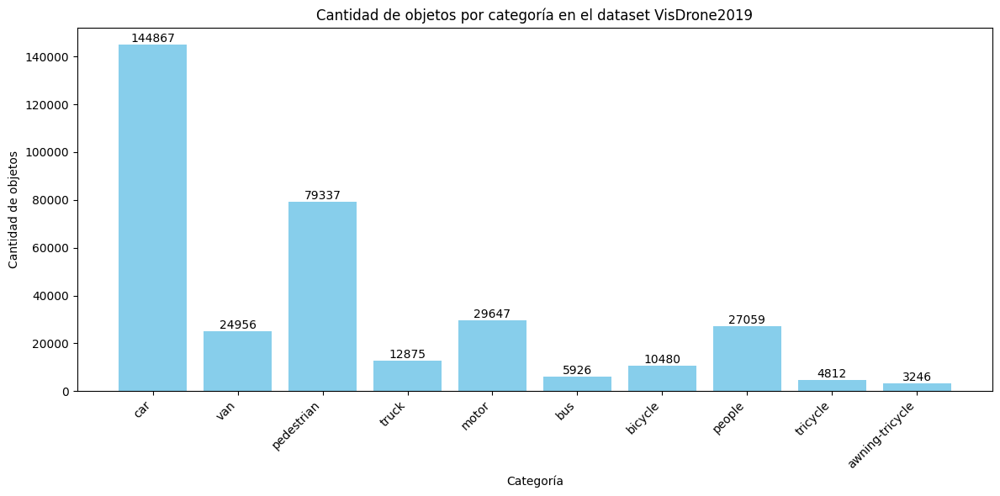

In [68]:
plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

Este gráfico permite visualizar la distribución de las clases en el dataset. Se puede ver que notoriamente la clase `car` es la que presenta mayor cantidad de detecciones, seguida por `pedestrian`. Entre las que presentan un número bastante menor se destacan `awning-tricycle`, `tricycle` y `bus`. Esto es necesario tenerlo en cuenta cuando se observen los resultados de los primeros entrenamientos. Es posible que los modelos tengan dificultades en detectar estas clases, aunque dependerá de las características particulares de las mismas y qué tan distinguibles son del resto.

## Bounding Boxes

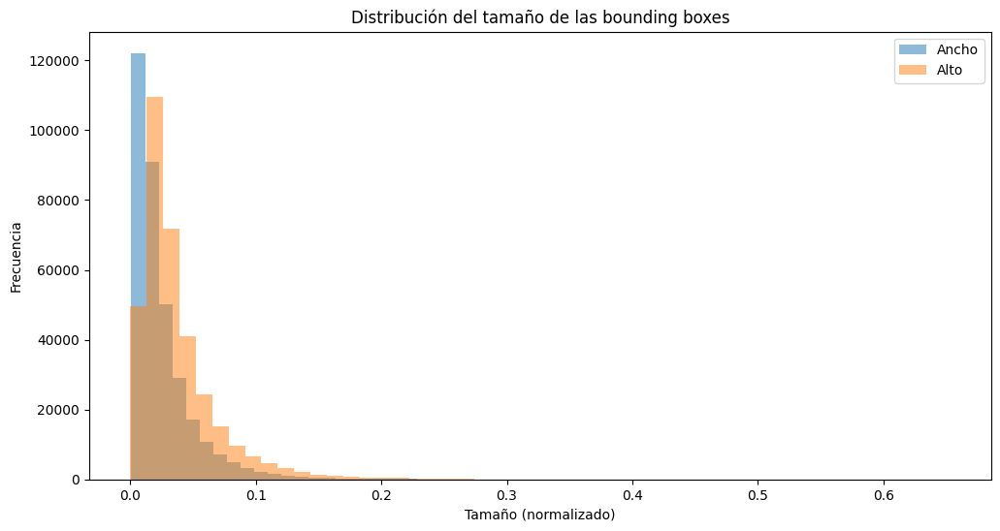

In [69]:
bbox_widths = []
bbox_heights = []

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                _, x_center, y_center, width, height, *_ = line.split()
                bbox_widths.append(float(width))
                bbox_heights.append(float(height))

plt.figure(figsize=(12, 6))
plt.hist(bbox_widths, bins=50, alpha=0.5, label='Ancho')
plt.hist(bbox_heights, bins=50, alpha=0.5, label='Alto')
plt.xlabel('Tamaño (normalizado)')
plt.ylabel('Frecuencia')
plt.title('Distribución del tamaño de las bounding boxes')
plt.legend()
plt.show()

Este gráfico muestra la distribución del ancho y alto de las *bounding boxes* del dataset. Se puede observar que la gran mayoría tiene un tamaño pequeño en relación con las dimensiones de la imagen. Tal como se mencionó anteriormente, tanto el ancho como el alto están normalizados entre 0 y 1.

El hecho de que haya *bounding boxes* tan pequeños en relación al tamaño de la imagen, sugiere que las mismas fueron tomadas a una distancia considerable de los diferentes objetivos. En este caso es normal, considerando las mismas fueron tomadas desde drones.

Esta información podría ser útil al momento del entrenamiento, ya que podría influir en el tamaño de la red y la estrategia de redimensionamiento de las imágenes.

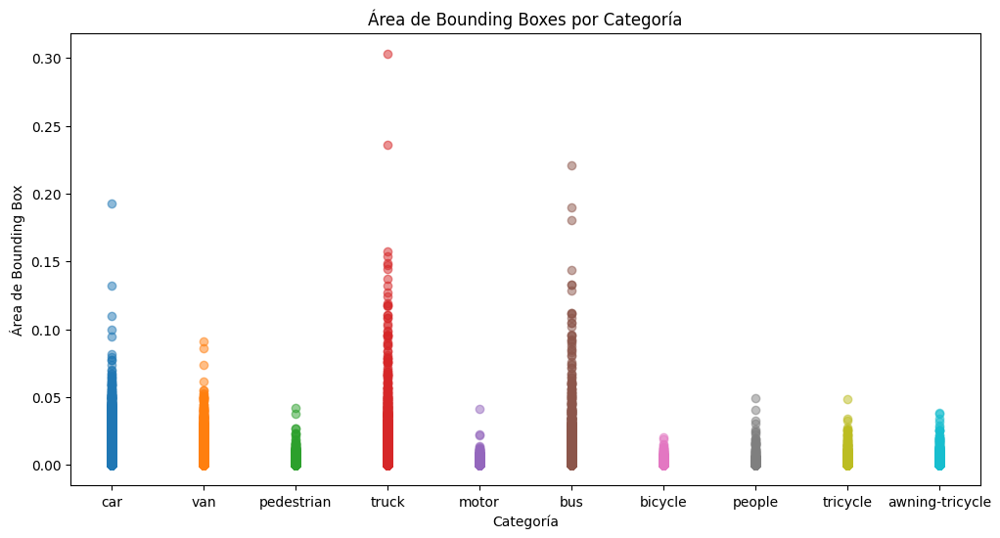

In [70]:
category_areas = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas:
                    category_areas[category] = []
                category_areas[category].append(area)

plt.figure(figsize=(12, 6))

for category, areas in category_areas.items():
  plt.scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)

plt.xlabel('Categoría')
plt.ylabel('Área de Bounding Box')
plt.title('Área de Bounding Boxes por Categoría')
#plt.legend()
plt.show()


Este gráfico muestra la distribución del área de las *bounding boxes* para cada categoría. Permite observar la variabilidad de los objetos detectados para cada clase.

Generalmente, se puede observar que los tamaños se distribuyen de acuerdo al tamaño de los objetos en la realidad. Lo que sugiere que las fotografías fueron tomadas utilizando un plano general y no enfocándose en un objeto particular.

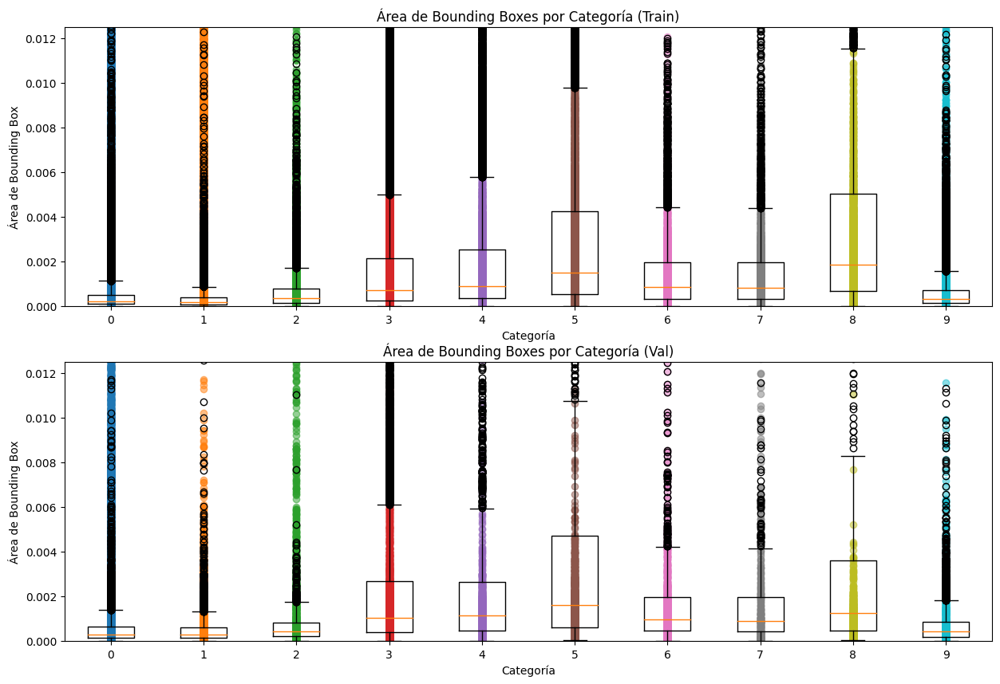

In [71]:
category_areas_train = {}
category_areas_val = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas_train:
                    category_areas_train[category] = []
                category_areas_train[category].append(area)

for filename in os.listdir(labels_dir_val):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_val, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas_val:
                    category_areas_val[category] = []
                category_areas_val[category].append(area)

fig, axs = plt.subplots(2, 1, figsize=(15, 10))

for category, areas in category_areas_train.items():
  axs[0].scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  axs[0].boxplot(areas, positions=[category], widths=0.5)

axs[0].set_xlabel('Categoría')
axs[0].set_ylabel('Área de Bounding Box')
axs[0].set_title('Área de Bounding Boxes por Categoría (Train)')
axs[0].set_ylim(0, 0.0125)

for category, areas in category_areas_val.items():
  axs[1].scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  axs[1].boxplot(areas, positions=[category], widths=0.5)

axs[1].set_xlabel('Categoría')
axs[1].set_ylabel('Área de Bounding Box')
axs[1].set_title('Área de Bounding Boxes por Categoría (Val)')
axs[1].set_ylim(0, 0.0125)

plt.show()

Se puede observar que las distribuciones mantienen su características en ambos datasets (train y validation). Las clases con mayor area corresponden a objetos de mayor tamaño (5-truck y 8-bus).

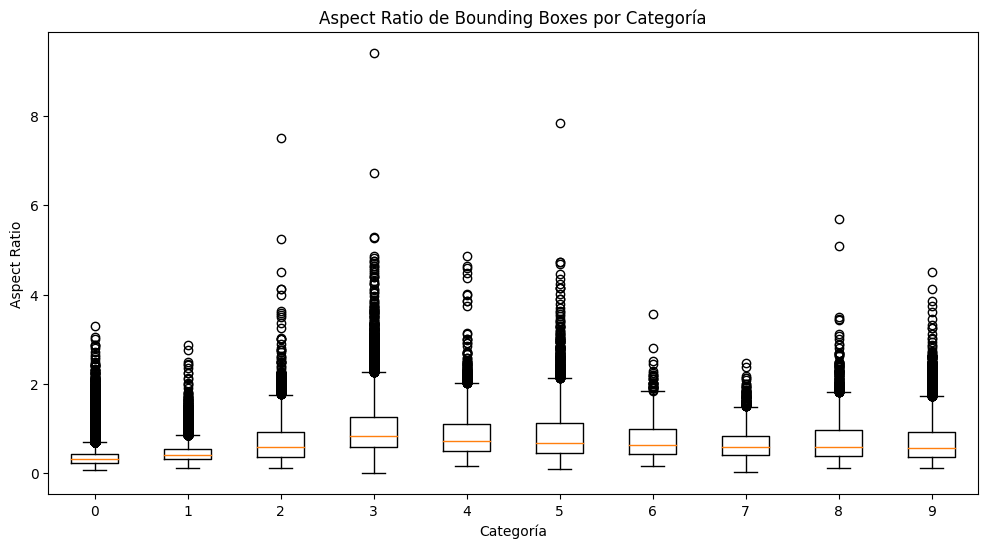

In [72]:
category_aspect_ratios = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                if float(height) == 0 or float(width) == 0:
                    aspect_ratio = 0
                else:
                    aspect_ratio = float(width) / float(height)
                if category not in category_aspect_ratios:
                    category_aspect_ratios[category] = []
                category_aspect_ratios[category].append(aspect_ratio)

plt.figure(figsize=(12, 6))

for category, aspect_ratios in category_aspect_ratios.items():
  #plt.scatter([df[df['label'] == category]['category'].values[0]] * len(aspect_ratios), aspect_ratios, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  plt.boxplot(aspect_ratios, positions=[category], widths=0.5)

plt.xlabel('Categoría')
plt.ylabel('Aspect Ratio')
plt.title('Aspect Ratio de Bounding Boxes por Categoría')
#plt.legend()
plt.show()


En este gráfico se muestra la relación entre el ancho y el alto (aspect ratio) de las bounding boxes para cada clase. Cada punto representa una bounding box y la dispersión de los mismos indica la variabilidad de las relaciones de aspecto para cada clase.

Se puede observar una gran variabilidad de relaciones de aspecto, siendo en su gran mayoría de formas aproximadamente cuadradas. Para algunas clases se observa que el valor de la media es cercano a un Aspect Ratio = 0 (width < height), sobretodo en lo que refiere a las clases 0-pedestrian y 1-people.

Esta dispersión de los puntos no indica necesariamente variaciones en los aspectos de los objetos en la realidad, si no que probablemente se debe al ángulo en que los drones capturaron las fotos.

file =  9999985_00000_d_0000020.txt line =  3 0.437857 0.150476 0.002857 0.000000



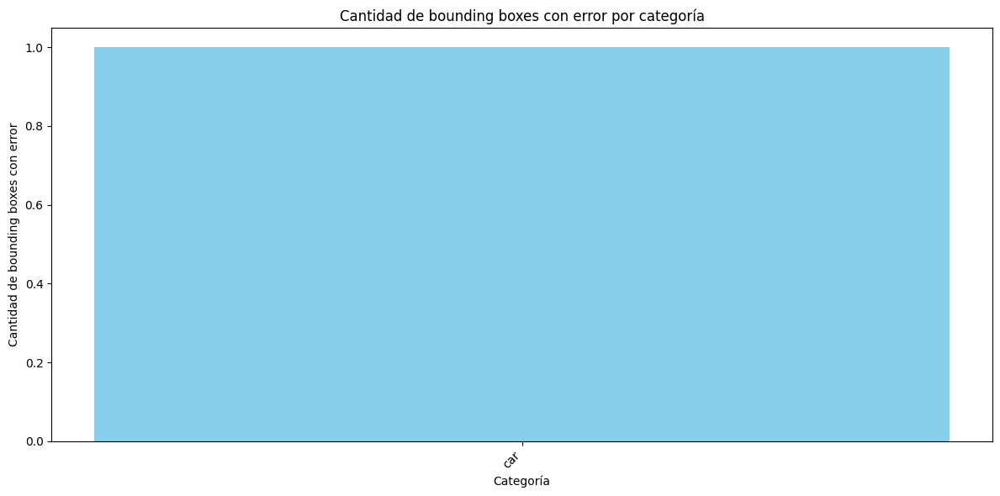

In [73]:
category_error_counts = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height = line.split()
                category = int(category)
                if float(width) <= 0 or float(height) <= 0 or float(x_center) < 0 or float(x_center) > 1 or float(y_center) < 0 or float(y_center) > 1:
                    if category not in category_error_counts:
                        category_error_counts[category] = 0
                    category_error_counts[category] += 1
                    print('file = ', filename, 'line = ', line)

# Convertir los datos a un DataFrame para facilitar el manejo
df_error_counts = pd.DataFrame(list(category_error_counts.items()), columns=['label', 'error_count'])

# Unir con el DataFrame original para obtener la categoría
df_merged_error = pd.merge(df_error_counts, df, on='label')

# Graficar la cantidad de bounding boxes con error por categoría
plt.figure(figsize=(12, 6))
plt.bar(df_merged_error['category'], df_merged_error['error_count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de bounding boxes con error')
plt.title('Cantidad de bounding boxes con error por categoría')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


Como se puede observar, hay sólo una anotación con error en el dataset en la que no se definió el alto de la bounding box. Esto no significa que el resto de las anotaciones sean perfectas, pero es una buena señal.

En las celdas siguientes se realizará una exploración visual de algunas imágenes del conjunto de entrenamiento.

# Visualización de las clases

In [74]:
def show_images_with_bboxes(image_files, images_dir, labels_dir, df):
  """
  Muestra imágenes con sus correspondientes bounding boxes.

  Args:
    image_files: Lista de nombres de archivos de imágenes.
    images_dir: Directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Cargar la imagen
      image = cv2.imread(image_path)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

      # Mostrar la imagen
      plt.figure(figsize=(10, 6))
      plt.imshow(image)
      plt.title(image_file)
      plt.axis('off')
      plt.show()


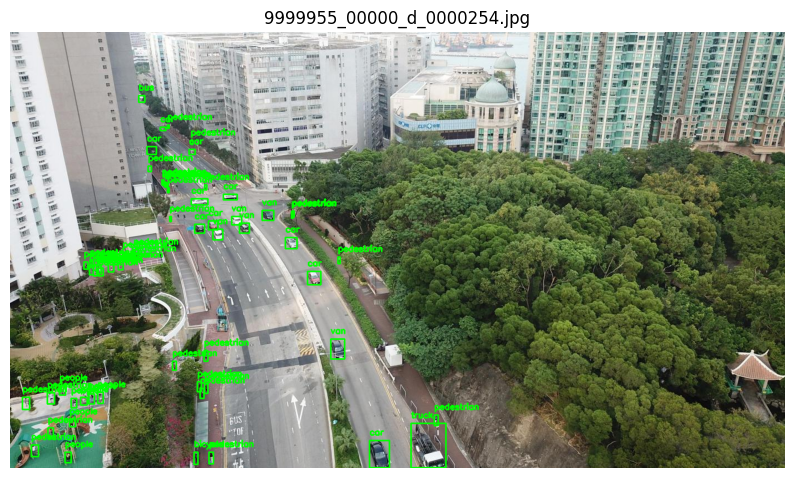

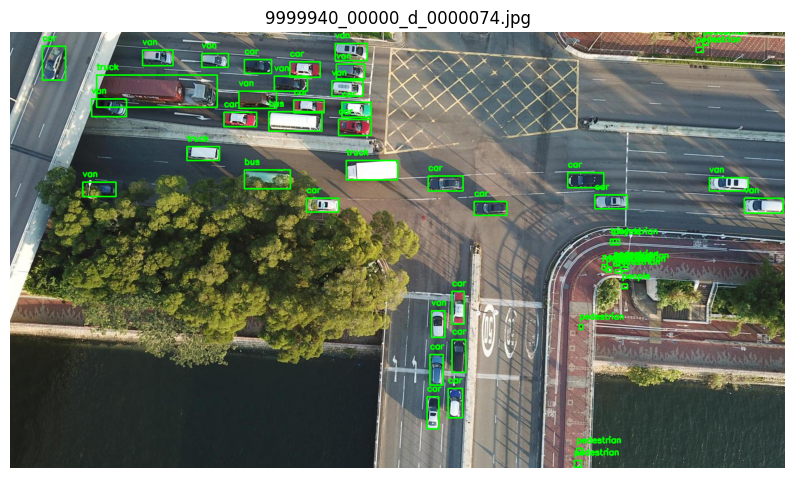

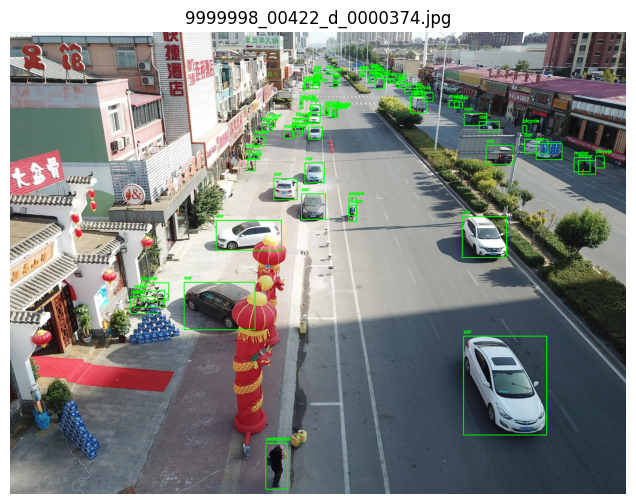

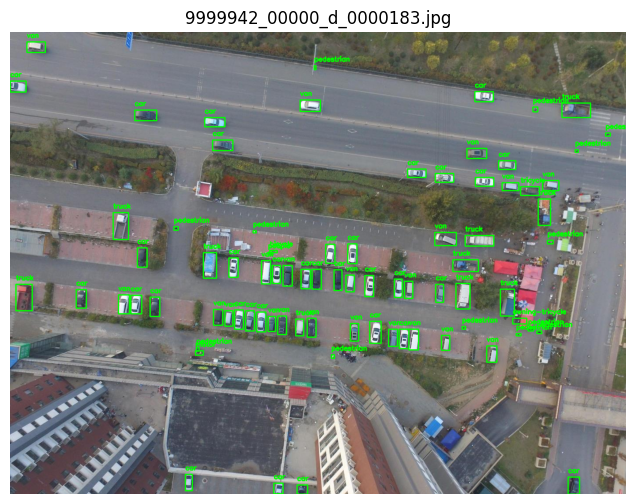

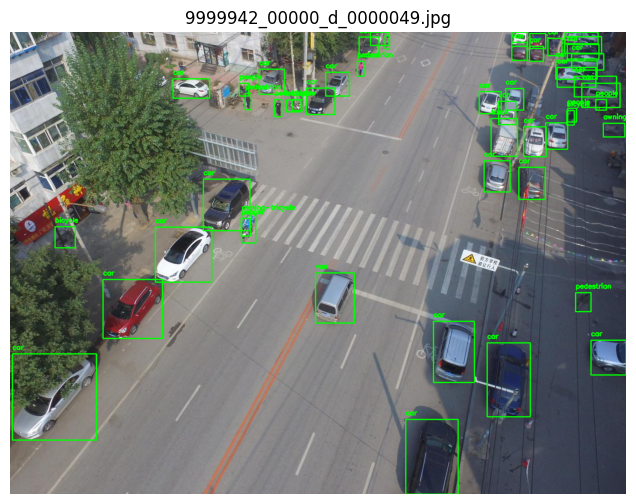

In [75]:
# Número de ejemplos a mostrar
num_examples = 5

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(images_dir_train) if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, images_dir_train, labels_dir_train, df)


In [76]:
def get_images_with_most_class(class_label, max_images=5):
  """
  Devuelve las imágenes con mayor cantidad de una clase dada.

  Args:
    class_label: Etiqueta de la clase a buscar.
    max_images: Número máximo de imágenes a devolver.

  Returns:
    Lista de nombres de archivos de imágenes con mayor cantidad de la clase.
  """
  labels_dir = 'VisDrone2019-DET-train/labels'
  class_image_counts = {}

  for filename in os.listdir(labels_dir):
      if filename.endswith('.txt'):
          with open(os.path.join(labels_dir, filename), 'r') as file:
              for line in file:
                  category, *_ = line.split()
                  category = int(category)
                  if category == class_label:  # Buscar la clase específica
                      image_name = filename.replace('.txt', '.jpg')
                      if image_name not in class_image_counts:
                          class_image_counts[image_name] = 0
                      class_image_counts[image_name] += 1

  sorted_images = sorted(class_image_counts.items(), key=lambda item: item[1], reverse=True)

  return [x[0] for x in sorted_images[:max_images]]

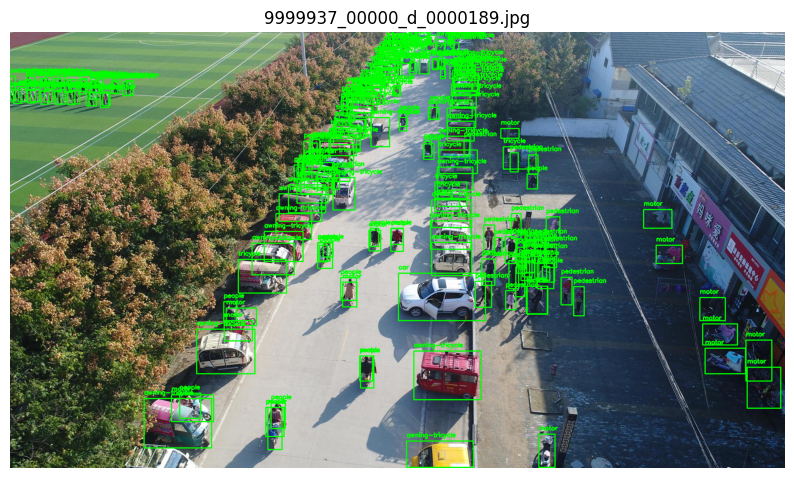

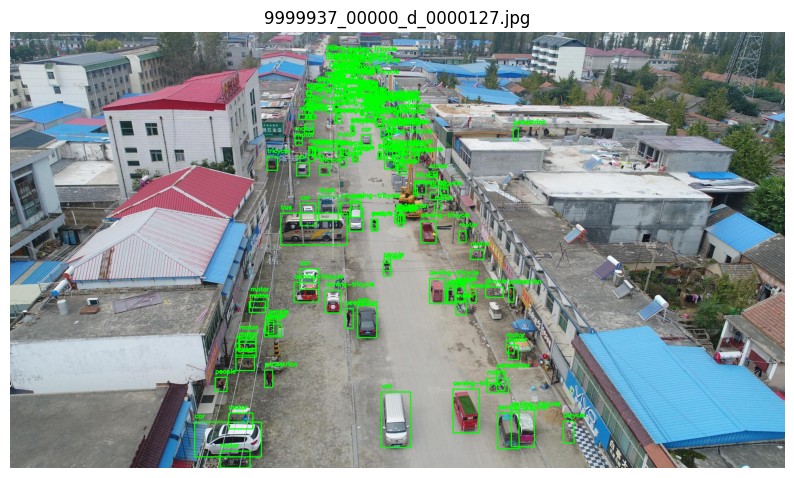

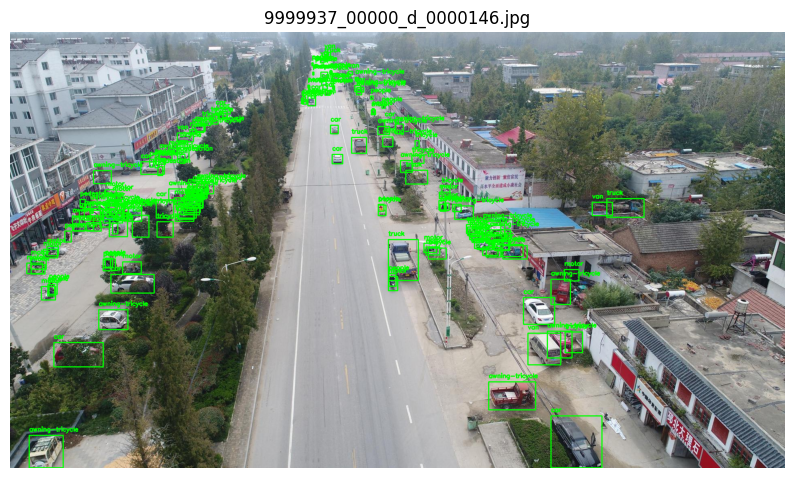

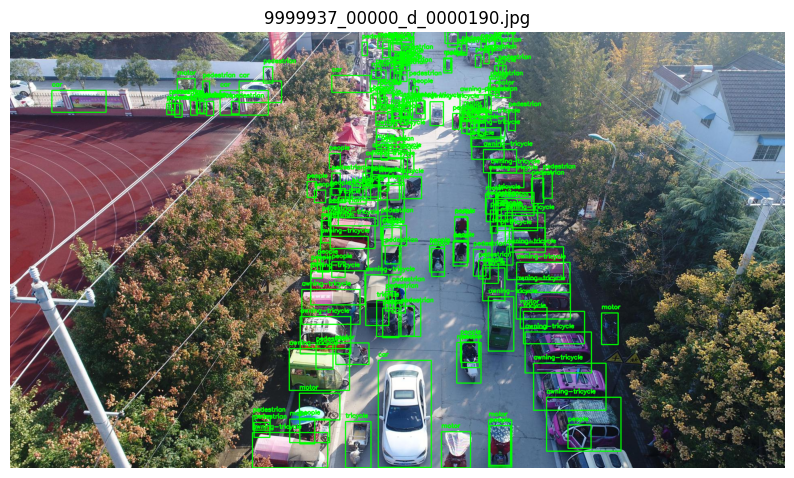

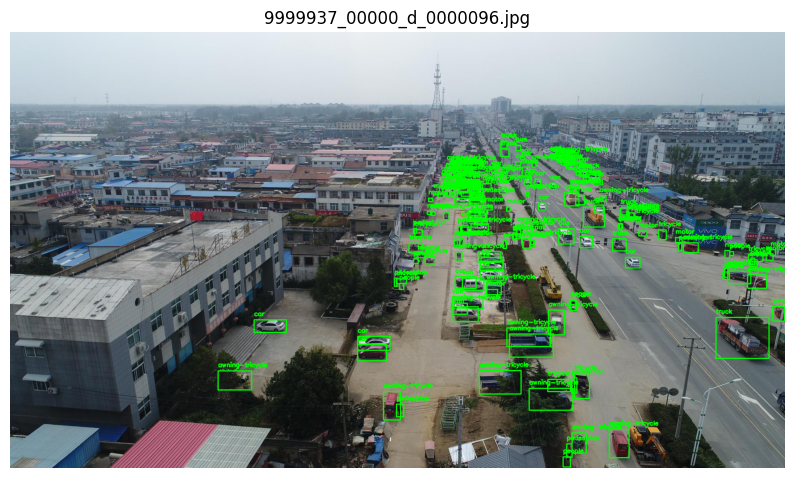

In [77]:
# Ejemplo de uso: obtener las 5 imágenes con más "awning-tricycle" (clase 7)
images_with_awning_tricycle = get_images_with_most_class(7, max_images=5)

# Mostrar las imágenes encontradas
show_images_with_bboxes(images_with_awning_tricycle, images_dir_train, labels_dir_train, df)

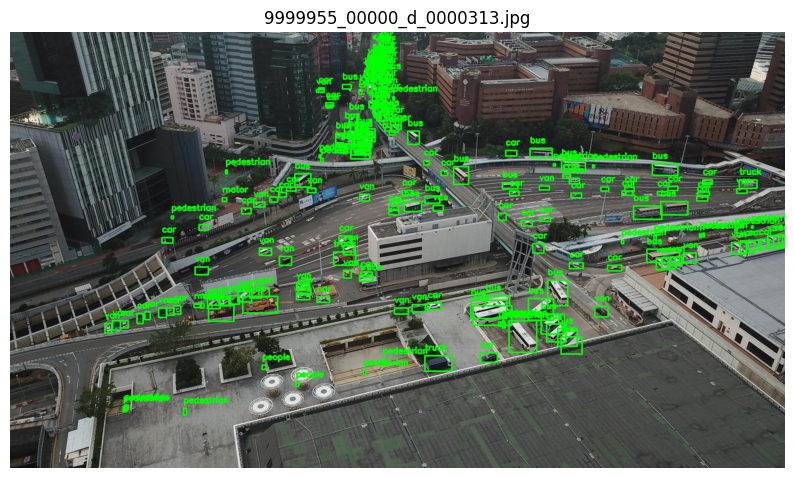

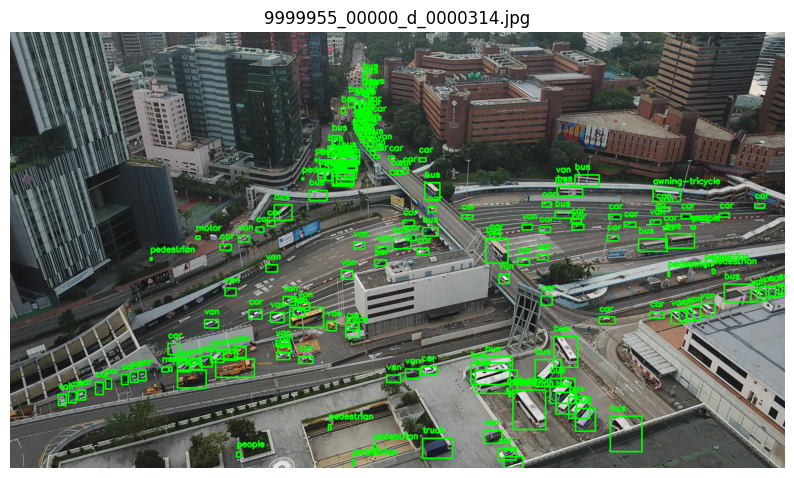

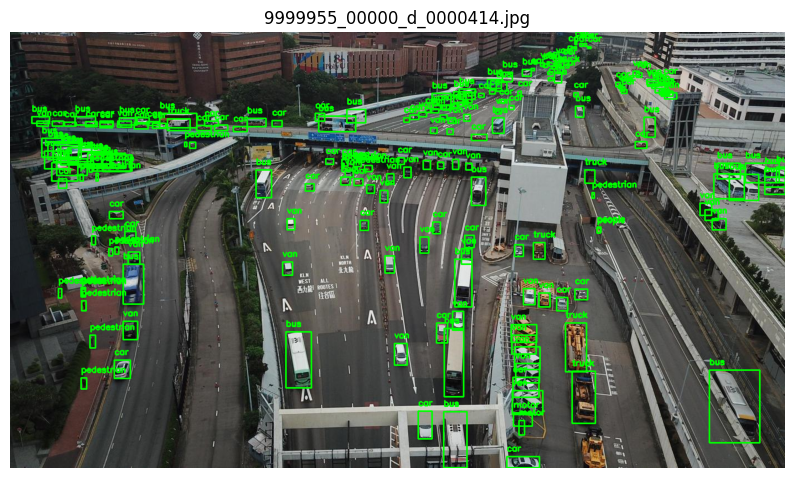

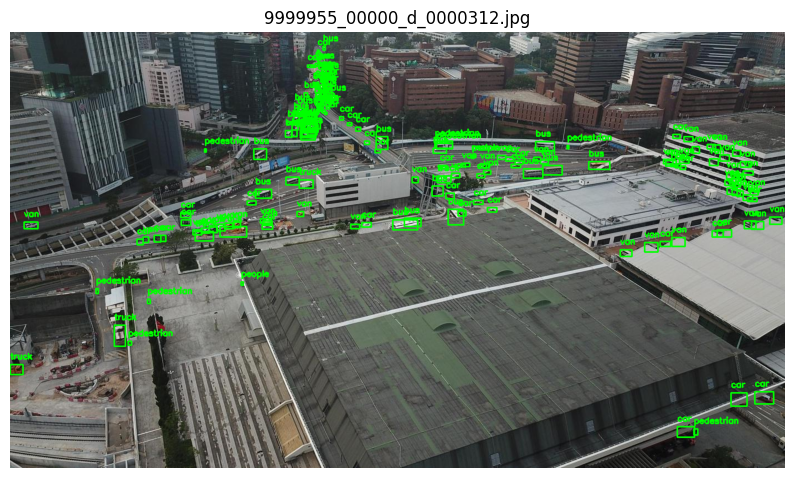

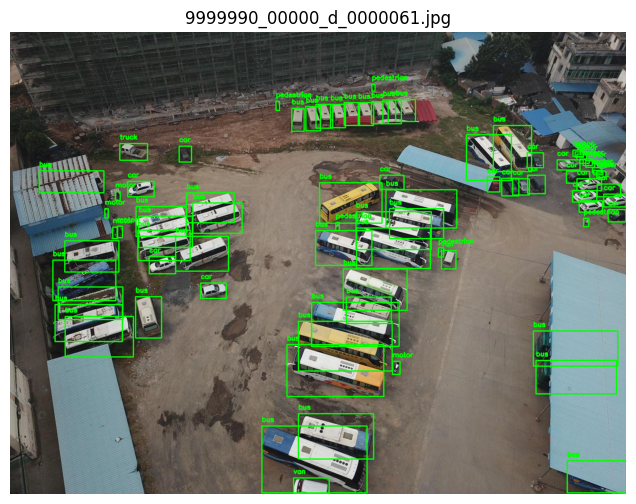

In [78]:
# Ejemplo de uso: obtener las 5 imágenes con más "bus" (clase 8)
images_with_awning_tricycle = get_images_with_most_class(8, max_images=5)

# Mostrar las imágenes encontradas
show_images_with_bboxes(images_with_awning_tricycle, images_dir_train, labels_dir_train, df)

In [79]:
def get_images_with_highest_proportion_of_class(class_name, labels_dir, max_images=5):
  """
  Dada una clase, devuelve las imágenes que tienen mayor proporción de dicha clase respecto a las demás.

  Args:
    class_name: El nombre de la clase a buscar (e.g., 'awning-tricycle').
    max_images: El máximo de imágenes a devolver.

  Returns:
    Una lista de tuplas (image_name, proportion), donde image_name es el nombre
    de la imagen y proportion es la proporción de la clase en la imagen.
  """

  class_label = df[df['category'] == class_name]['label'].values[0]
  images_with_class_counts = {}

  for filename in os.listdir(labels_dir):
    if filename.endswith('.txt'):
      with open(os.path.join(labels_dir, filename), 'r') as file:
        total_objects = 0
        class_objects = 0
        for line in file:
          category, *_ = line.split()
          category = int(category)
          total_objects += 1
          if category == class_label:
            class_objects += 1

        if total_objects > 0:
          proportion = class_objects / total_objects
          image_name = filename.replace('.txt', '.jpg')
          images_with_class_counts[image_name] = proportion

  sorted_images = sorted(images_with_class_counts.items(), key=lambda item: item[1], reverse=True)

  return sorted_images[:max_images]


Imágenes con mayor proporción de la clase 'awning-tricycle':
- 9999937_00000_d_0000183.jpg: Proporción = 0.33
- 9999937_00000_d_0000224.jpg: Proporción = 0.26
- 9999942_00000_d_0000158.jpg: Proporción = 0.25
- 9999937_00000_d_0000219.jpg: Proporción = 0.24
- 9999937_00000_d_0000184.jpg: Proporción = 0.23


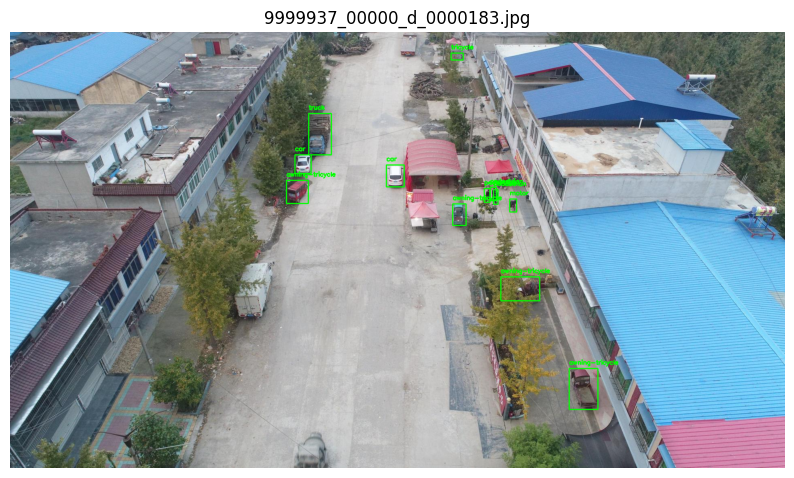

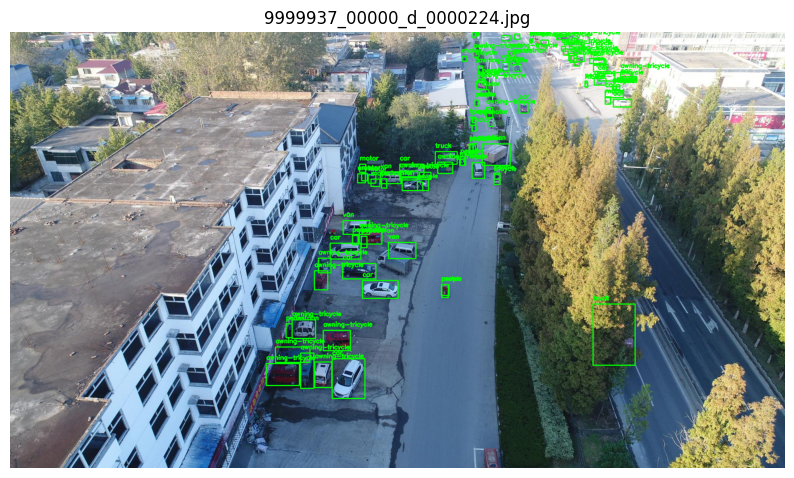

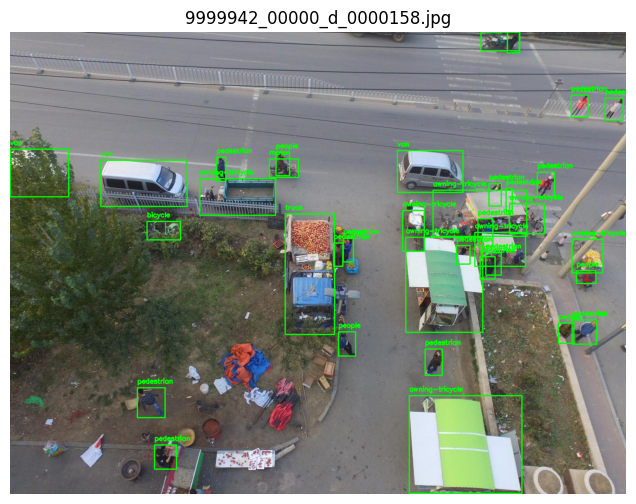

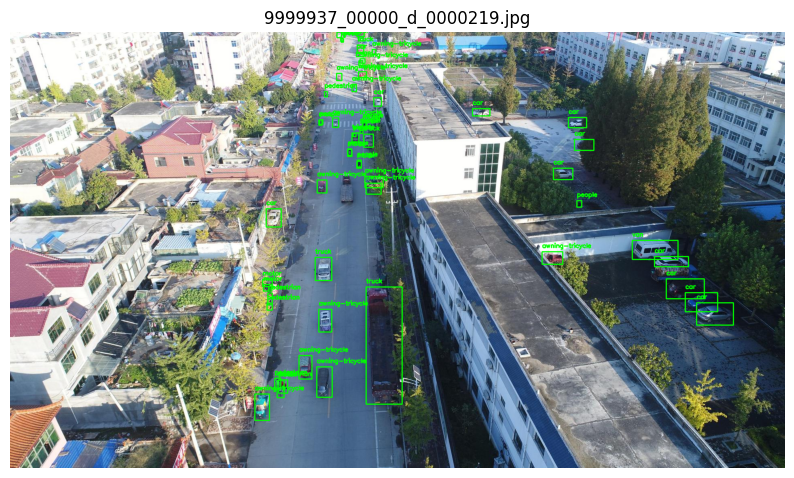

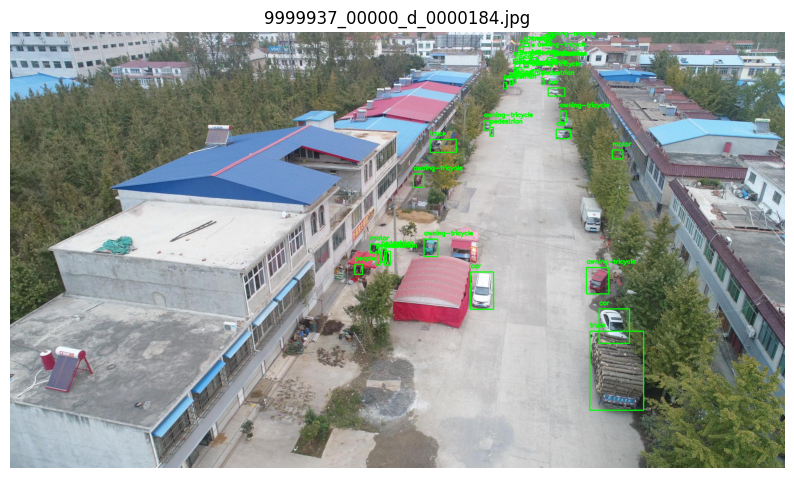

In [80]:
# Ejemplo de uso:
class_name_to_search = 'awning-tricycle'
max_images_to_return = 5
result = get_images_with_highest_proportion_of_class(class_name_to_search, labels_dir_train, max_images_to_return)

print(f"Imágenes con mayor proporción de la clase '{class_name_to_search}':")
for image_name, proportion in result:
  print(f"- {image_name}: Proporción = {proportion:.2f}")

show_images_with_bboxes([x[0] for x in result], images_dir_train, labels_dir_train, df)

Imágenes con mayor proporción de la clase 'bus':
- 9999956_00000_d_0000001.jpg: Proporción = 0.89
- 9999955_00000_d_0000120.jpg: Proporción = 0.75
- 9999955_00000_d_0000116.jpg: Proporción = 0.71
- 9999955_00000_d_0000118.jpg: Proporción = 0.70
- 9999951_00000_d_0000297.jpg: Proporción = 0.67


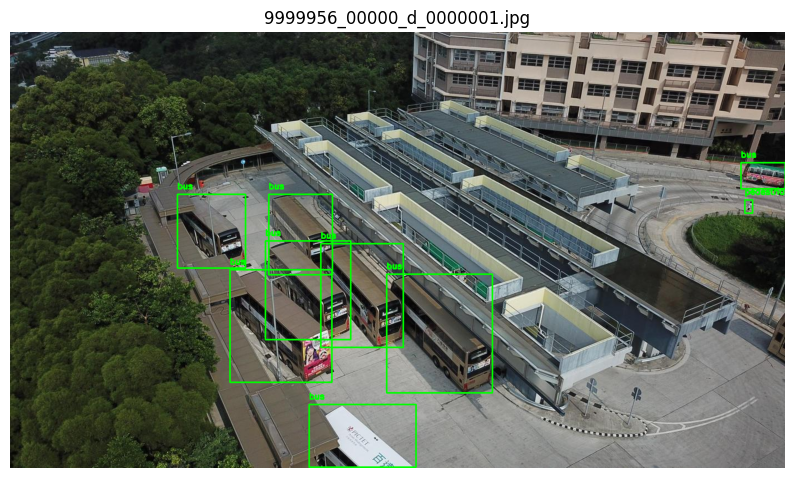

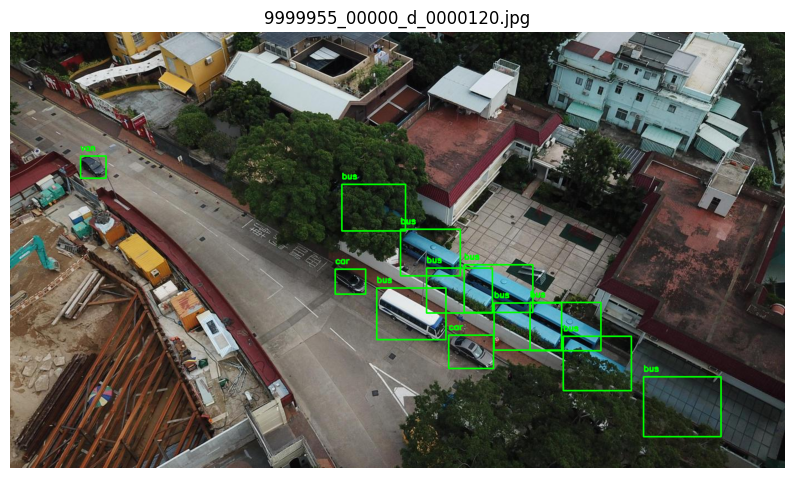

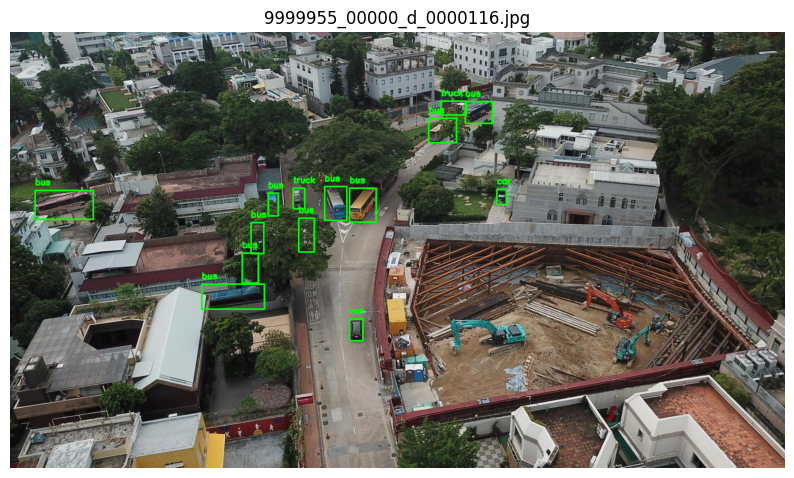

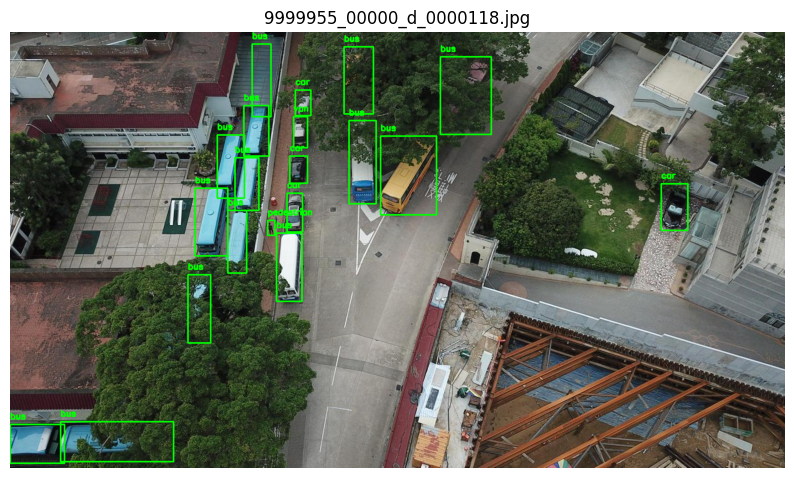

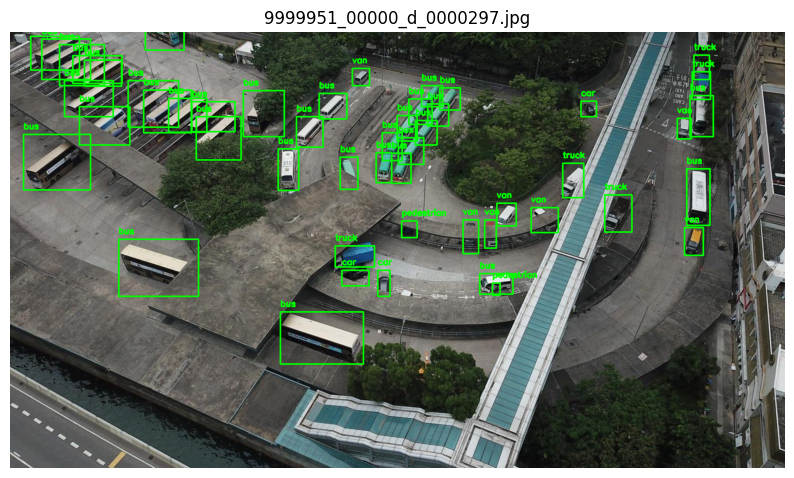

In [81]:
# Otro ejemplo de uso:
class_name_to_search = 'bus'
max_images_to_return = 5
result = get_images_with_highest_proportion_of_class(class_name_to_search, labels_dir_train, max_images_to_return)

print(f"Imágenes con mayor proporción de la clase '{class_name_to_search}':")
for image_name, proportion in result:
  print(f"- {image_name}: Proporción = {proportion:.2f}")

show_images_with_bboxes([x[0] for x in result], images_dir_train, labels_dir_train, df)

# Preprocesamiento
Filtrado según area del label en la imágen

In [82]:
def bounding_box_areas(image_file, images_dir, labels_dir):
  """
  Calcula el área de cada bounding box en una imagen y la asocia a su clase.

  Args:
    image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
    images_dir: El directorio donde se encuentra la imagen.
    labels_dir: El directorio donde se encuentra el archivo de etiquetas.

  Returns:
    Un diccionario donde las claves son los IDs de clase y los valores son
    listas de áreas de bounding boxes para esa clase.
  """

  image_path = os.path.join(images_dir, image_file)
  label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

  areas = {}
  if os.path.exists(label_path):
    with open(label_path, 'r') as f:
      for line in f:
        class_id, x_center, y_center, width, height, *_ = line.strip().split()
        class_id = int(class_id)
        area = float(width) * float(height)
        if class_id not in areas:
          areas[class_id] = []
        areas[class_id].append(area)
  return areas

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'  # Reemplazar con el nombre de tu imagen
images_dir = 'VisDrone2019-DET-train/images'  # Reemplazar con la ruta a tus imágenes
labels_dir = 'VisDrone2019-DET-train/labels'  # Reemplazar con la ruta a tus etiquetas

areas = bounding_box_areas(image_file, images_dir, labels_dir)

print(f"Áreas de las bounding boxes en {image_file}:")
for class_id, areas_list in areas.items():
  for i, area in enumerate(areas_list):
    print(f"  Clase {class_id}, Bounding box {i+1}: {area}")

Áreas de las bounding boxes en 9999937_00000_d_0000219.jpg:
  Clase 3, Bounding box 1: 0.0024231949000000003
  Clase 3, Bounding box 2: 0.0018204326459999999
  Clase 3, Bounding box 3: 0.002230067755
  Clase 3, Bounding box 4: 0.0010167166309999998
  Clase 3, Bounding box 5: 0.000650700648
  Clase 3, Bounding box 6: 0.0006042291880000001
  Clase 3, Bounding box 7: 0.000544663826
  Clase 3, Bounding box 8: 0.00037475321400000003
  Clase 3, Bounding box 9: 0.000806118384
  Clase 3, Bounding box 10: 0.000183023995
  Clase 3, Bounding box 11: 9.586658e-05
  Clase 3, Bounding box 12: 7.4558367e-05
  Clase 3, Bounding box 13: 5.325467599999999e-05
  Clase 4, Bounding box 1: 0.002571338223
  Clase 4, Bounding box 2: 6.390765200000001e-05
  Clase 7, Bounding box 1: 0.000765453826
  Clase 7, Bounding box 2: 0.001379841309
  Clase 7, Bounding box 3: 0.0008705325399999999
  Clase 7, Bounding box 4: 0.00084051864
  Clase 7, Bounding box 5: 0.0011329203330000001
  Clase 7, Bounding box 6: 0.0003718

In [83]:
def filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold=0.001):
    """
    Filtra las bounding boxes en una imagen basándose en un umbral de área.

    Args:
      image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
      images_dir: El directorio donde se encuentra la imagen.
      labels_dir: El directorio donde se encuentra el archivo de etiquetas.
      area_threshold: El umbral de área mínima para las bounding boxes.

    Returns:
      Una lista de líneas (labels) que cumplen con el criterio de área.
    """

    image_path = os.path.join(images_dir, image_file)
    label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

    filtered_lines = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                class_id, x_center, y_center, width, height, *_ = line.strip().split()
                area = float(width) * float(height)
                if area >= area_threshold:
                    filtered_lines.append(line)
    return filtered_lines

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
area_threshold = 0.001  # Puedes ajustar este valor

filtered_labels = filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold)

print(f"Labels filtrados para {image_file}:")
for line in filtered_labels:
    print(line.strip())

Labels filtrados para 9999937_00000_d_0000219.jpg:
3 0.909447 0.647032 0.047495 0.051020
3 0.892484 0.620130 0.041754 0.043599
3 0.871086 0.590445 0.049061 0.045455
4 0.832724 0.501391 0.058977 0.043599
3 0.853862 0.528293 0.043841 0.023191
5 0.482516 0.720315 0.046451 0.268089
7 0.406054 0.803803 0.019833 0.069573
7 0.325157 0.860390 0.018789 0.060297
5 0.404749 0.544527 0.021399 0.053803


# Nuevo dataset
Se va a armar un nuevo dataset filtrando los labels que ocupen un area muy pequeña en realacion a la imagen.

In [84]:
import os
import shutil
import random
from shutil import copyfile

In [85]:
def filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold=0.001, num_images=50):
    """
    Selecciona imágenes aleatorias, filtra las bounding boxes por área y guarda las imágenes y
    labels filtrados en un nuevo directorio.

    Args:
      images_dir: Directorio de imágenes.
      labels_dir: Directorio de etiquetas.
      output_dir: Directorio de salida.
      area_threshold: Umbral de área para filtrar bounding boxes.
      num_images: Número de imágenes a seleccionar.
    """
    # Crea el directorio de salida si no existe
    os.makedirs(output_dir, exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'labels'), exist_ok=True)

    # Selecciona imágenes aleatorias
    image_files = random.sample(os.listdir(images_dir), num_images)

    for image_file in image_files:
        # Copia la imagen al directorio de salida
        image_path = os.path.join(images_dir, image_file)
        output_image_path = os.path.join(output_dir, 'images', image_file)
        copyfile(image_path, output_image_path)

        # Filtra las bounding boxes
        label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))
        filtered_labels = filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold)

        # Guarda las etiquetas filtradas
        if len(filtered_labels) > 0: # no se guardan los .txt sin labels
            output_label_path = os.path.join(output_dir, 'labels', image_file.replace('.jpg', '.txt'))
            with open(output_label_path, 'w') as f:
                for line in filtered_labels:
                    f.write(line)


In [86]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
output_dir = 'VisDrone-AreaFilter-train'
area_threshold = 0.001
num_images = 1500

filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold, num_images)

In [87]:
def delete_images_without_labels(images_dir, labels_dir):
  """
  Elimina las imágenes que no tienen un archivo de etiquetas correspondiente.

  Args:
    images_dir: Directorio de imágenes.
    labels_dir: Directorio de etiquetas.
  """
  for image_file in os.listdir(images_dir):
    if image_file.endswith('.jpg'):
      label_file = image_file.replace('.jpg', '.txt')
      label_path = os.path.join(labels_dir, label_file)
      if not os.path.exists(label_path):
        image_path = os.path.join(images_dir, image_file)
        os.remove(image_path)
        print(f"Imagen eliminada: {image_file}")

In [88]:
# Ejemplo de uso
delete_images_without_labels(images_dir, labels_dir)

In [89]:
#!rm -rf /content/VisDrone-AreaFilter-train

## Visualización de las clases

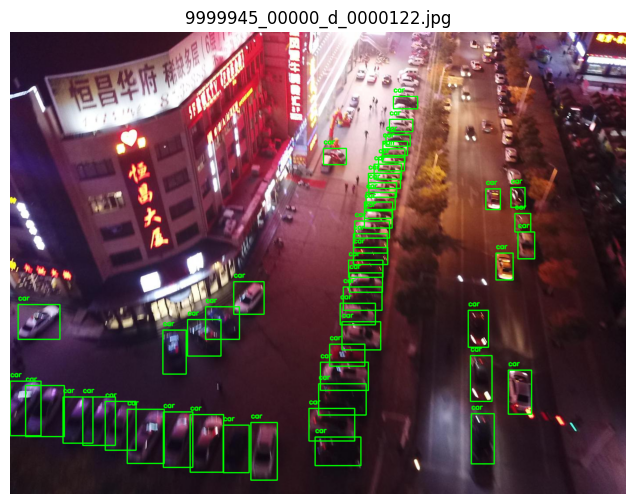

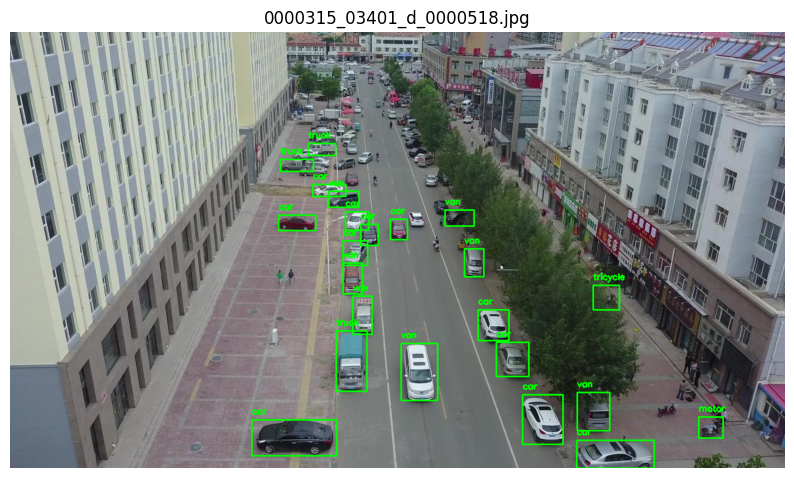

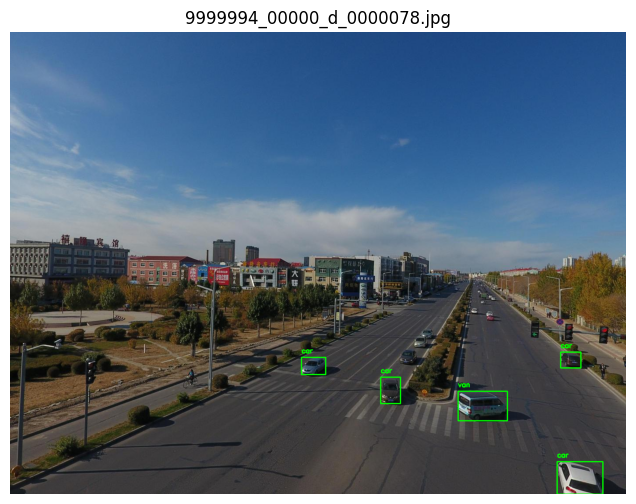

In [90]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df)

Repetimos proceso para dataset de validacion

In [91]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-val/images'
labels_dir = 'VisDrone2019-DET-val/labels'
output_dir = 'VisDrone-AreaFilter-val'
area_threshold = 0.001
num_images = 100

filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold, num_images)

In [92]:
delete_images_without_labels(images_dir, labels_dir)

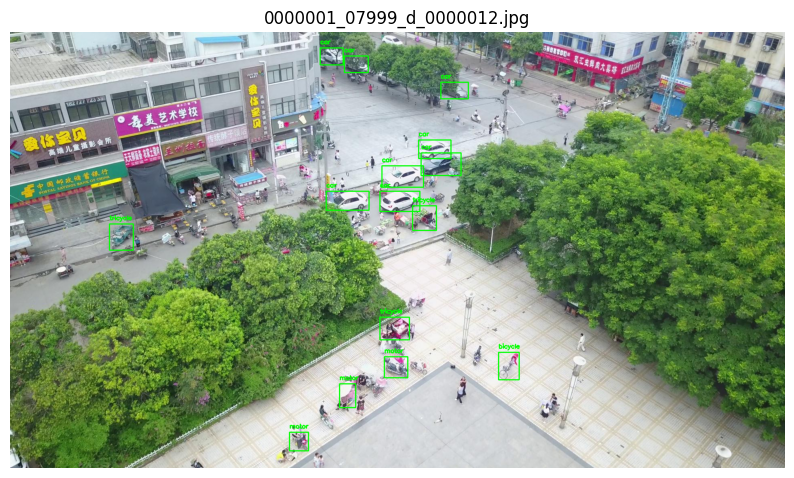

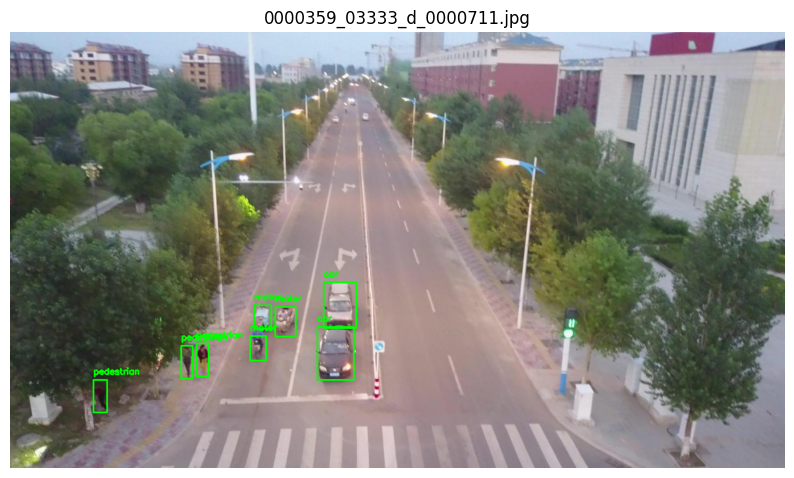

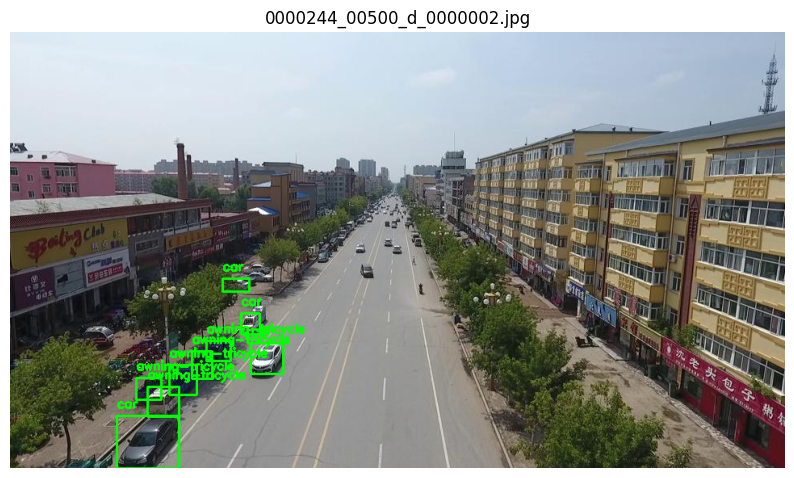

In [93]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df)

Listo, ahora tenemos un nuevo dataset mas pequeño enfocado a objetos de gran tamaño.

## Nuevo balance de clases:

Cantidad de imagenes: 480


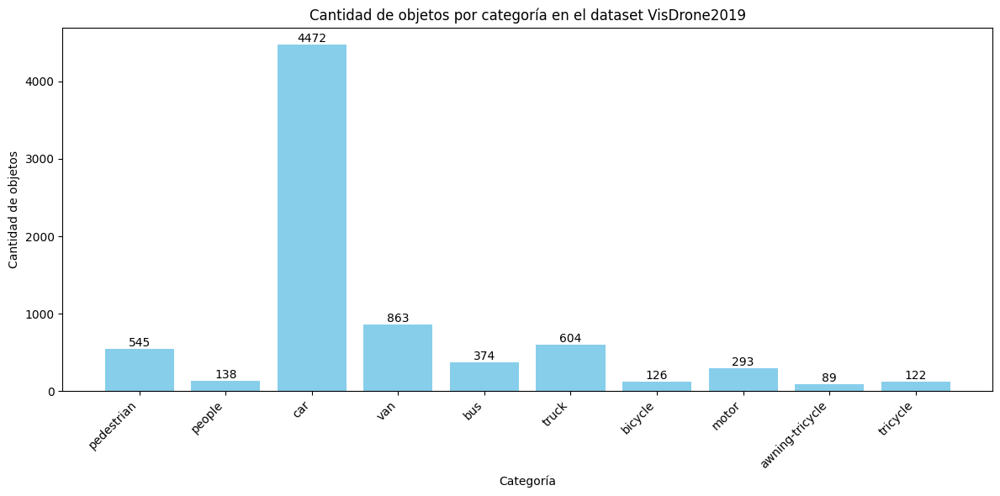

In [94]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-AreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

---

In [95]:
# Se carga tensorboard para el próximo entrenamiento
# Ajustar directorio en caso que no sea la primera ejecución (podría ser train2, train3, ...)

%load_ext tensorboard
%tensorboard --logdir runs/detect/train

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [96]:
def predict_and_show_images_comparison(image_files, model, images_dir, labels_dir, df, confidence_threshold=0.5):
  """
  Realiza predicciones con el modelo YOLO en un conjunto de imágenes y muestra las imágenes con las bounding boxes, comparando
  la predicción con las etiquetas reales.

  Args:
    image_files: Una lista de nombres de archivos de imágenes.
    model: El modelo YOLO a utilizar para las predicciones.
    images_dir: El directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
    confidence_threshold: El umbral de confianza para las predicciones.
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Realizar la predicción
      results = model(image_path)

      # Obtener la primera predicción (si hay más de una)
      predicted_image = cv2.imread(image_path)
      predicted_image = cv2.cvtColor(predicted_image, cv2.COLOR_BGR2RGB)
      if results and results[0].boxes:
          boxes = results[0].boxes.xywh.cpu().numpy()  # Coordenadas de las bounding boxes
          confidence = results[0].boxes.conf.cpu().numpy()
          class_ids = results[0].boxes.cls.cpu().numpy().astype(int)

          for box, conf, cls_id in zip(boxes, confidence, class_ids):
              if conf >= confidence_threshold:
                  x_center, y_center, width, height = box
                  x_min = int(x_center - width / 2)
                  y_min = int(y_center - height / 2)
                  x_max = int(x_center + width / 2)
                  y_max = int(y_center + height / 2)

                  # Dibujar la bounding box
                  cv2.rectangle(predicted_image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == cls_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(predicted_image, f"{category}: {conf:.2f}", (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)


      # Cargar la imagen real con las bounding boxes reales
      real_image = cv2.imread(image_path)
      real_image = cv2.cvtColor(real_image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = real_image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(real_image, (x_min, y_min), (x_max, y_max), (0, 0, 255), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(real_image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)


      # Combinar las imágenes lado a lado
      combined_image = np.concatenate((predicted_image, real_image), axis=1)

      # Mostrar la imagen combinada
      plt.figure(figsize=(15, 6))
      plt.imshow(combined_image)
      plt.title(f"Predicción vs. Real - {image_file}")
      plt.axis('off')
      plt.show()


In [97]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone-AreaFilter-train/images'
labels_dir_train = 'VisDrone-AreaFilter-train/labels'

images_dir_val = 'VisDrone-AreaFilter-val/images'
labels_dir_val = 'VisDrone-AreaFilter-val/labels'

# Entrenamiento N 3

## Eliminamos algunas clases

Se van a eliminar las clases menos representativas, de peor calidad de imagen y que resultaron teniendo un mal rendimiento. El problema se va a enfocar solamente a vehículos de "gran" porte.

In [98]:
def delete_specific_labels(labels_dir, labels_to_delete):
    """
    Deletes specific labels from annotation files in a directory.

    Args:
        labels_dir: The directory containing the annotation files.
        labels_to_delete: A list of labels to delete.
    """
    for filename in os.listdir(labels_dir):
        if filename.endswith('.txt'):
            filepath = os.path.join(labels_dir, filename)
            with open(filepath, 'r') as f:
                lines = f.readlines()

            filtered_lines = [line for line in lines if line.split()[0] not in labels_to_delete]

            with open(filepath, 'w') as f:
                f.writelines(filtered_lines)

In [99]:
df

,label,category
0,0,pedestrian
1,1,people
2,2,bicycle
3,3,car
4,4,van
5,5,truck
6,6,tricycle
7,7,awning-tricycle
8,8,bus
9,9,motor


In [100]:
# Specify the labels to delete (corresponding class IDs from label_map.txt)
labels_to_delete = ['1', '2', '6', '7']  # people, bicycle, tricycle, awning-tricycle

# Specify the directories for train and validation datasets
train_labels_dir = 'VisDrone-AreaFilter-train/labels'
val_labels_dir = 'VisDrone-AreaFilter-val/labels'

# Delete the labels from the datasets
delete_specific_labels(train_labels_dir, labels_to_delete)
delete_specific_labels(val_labels_dir, labels_to_delete)


- Chequeo balanceo de clases

Cantidad de imagenes: 480


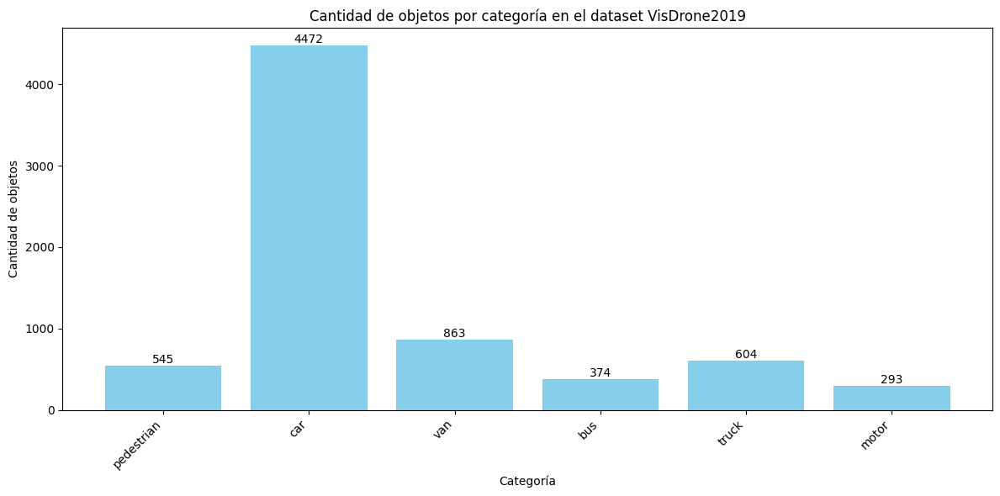

In [101]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-AreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

In [102]:
def remap_class_ids(labels_dir, class_id_mapping):
    """
    Remaps class IDs in annotation files according to a mapping.

    Args:
        labels_dir: The directory containing the annotation files.
        class_id_mapping: A dictionary mapping old class IDs to new class IDs.
    """
    for filename in os.listdir(labels_dir):
        if filename.endswith('.txt'):
            filepath = os.path.join(labels_dir, filename)
            with open(filepath, 'r') as f:
                lines = f.readlines()

            updated_lines = []
            for line in lines:
                parts = line.strip().split()
                old_class_id = int(parts[0])
                if old_class_id in class_id_mapping:
                    new_class_id = class_id_mapping[old_class_id]
                    parts[0] = str(new_class_id)
                    updated_lines.append(' '.join(parts) + '\n')

            with open(filepath, 'w') as f:
                f.writelines(updated_lines)

In [103]:
# Buscamos evitar que yolo ignore las clases cuyo id supere el numero total de clases.

class_id_mapping = {
    0: 0,  # pedestrian remains 0
    3: 1,  # car becomes 1
    4: 2,  # van becomes 2
    5: 3,  # truck becomes 3
    8: 4,  # bus becomes 4
    9: 5   # motor becomes 5
}
remap_class_ids(train_labels_dir, class_id_mapping)
remap_class_ids(val_labels_dir, class_id_mapping)

print("Class IDs remapped in the datasets.")

Class IDs remapped in the datasets.


Cantidad de imagenes: 480


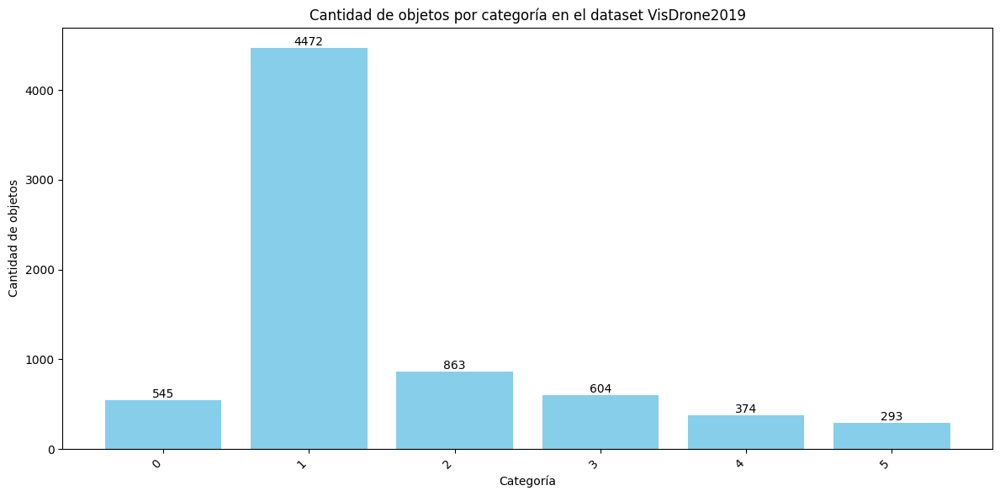

In [104]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-AreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['label'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

In [105]:
%%writefile data.yaml
train: /content/VisDrone-AreaFilter-train/images
val: /content/VisDrone-AreaFilter-val/images

nc: 6
names: ['pedestrian', 'car', 'van', 'truck', 'bus', 'motor']


Overwriting data.yaml


## Entrenamos

In [106]:
# Cargar el modelo YOLOv8
model_3 = YOLO('yolov8m.pt')

# Entrenar el modelo congelando las primeras 10 capas (hasta el bloque SPPF)
results_3 = model_3.train(
    data='data.yaml',
    imgsz=1080,
    batch=16,
    epochs=22,
    freeze=16,  # Congela las primeras 16 capas
    auto_augment=False, # Desactivar auto augmentation
    mosaic=1,          # Desactivar mosaic
    hsv_h=0.015,           # No variación en matiz
    hsv_s=0.7,           # No variación en saturación
    hsv_v=0.4,           # No variación en brillo
    degrees=20,         # Sin rotación
    translate=0.1,       # Sin traslación
    scale=0.5,           # Sin escalado
    shear=0,           # Sin corte
    flipud=0.5,          # No flip vertical
    fliplr=0.5,          # No flip horizontal
    copy_paste=1      # Desactivar Copy-Paste
    ,plots=True
)


Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=data.yaml, epochs=22, time=None, patience=100, batch=16, imgsz=1080, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=16, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=

train: Scanning /content/VisDrone-AreaFilter-train/labels.cache... 480 images, 22 backgrounds, 0 corrupt: 100%|██████████| 500/500 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/VisDrone-AreaFilter-val/labels.cache... 50 images, 0 backgrounds, 0 corrupt: 100%|██████████| 50/50 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 83 weight(decay=0.0), 90 weight(decay=0.0005), 89 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 1088 train, 1088 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 22 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/22      8.21G       1.81      3.435      1.435         39       1088: 100%|██████████| 32/32 [00:38<00:00,  1.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]

                   all         50       1016     0.0269      0.464      0.103     0.0392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/22      6.26G      1.652      2.461       1.28        132       1088: 100%|██████████| 32/32 [00:29<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.32s/it]

                   all         50       1016     0.0532      0.302      0.106      0.049



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/22       7.4G      1.642      2.261      1.262         88       1088: 100%|██████████| 32/32 [00:29<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.20s/it]

                   all         50       1016      0.615       0.17      0.262      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/22      6.28G      1.627      2.207      1.254        122       1088: 100%|██████████| 32/32 [00:30<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.25it/s]

                   all         50       1016      0.472      0.394      0.295      0.128



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/22      6.11G      1.597      2.078      1.258         28       1088: 100%|██████████| 32/32 [00:36<00:00,  1.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.19it/s]

                   all         50       1016      0.393       0.41      0.373      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/22      7.14G      1.563      1.986      1.216        153       1088: 100%|██████████| 32/32 [00:31<00:00,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.35s/it]

                   all         50       1016       0.44      0.423      0.378      0.171



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/22      6.99G      1.563      1.887      1.213        143       1088: 100%|██████████| 32/32 [00:31<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.27s/it]

                   all         50       1016      0.394      0.455      0.385      0.169



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/22      6.06G       1.56      1.893      1.219         85       1088: 100%|██████████| 32/32 [00:29<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         50       1016      0.457      0.444      0.416      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/22      7.52G       1.54      1.778      1.217         75       1088: 100%|██████████| 32/32 [00:32<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.16it/s]

                   all         50       1016      0.374       0.47      0.398      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/22      6.62G      1.545      1.793      1.194        116       1088: 100%|██████████| 32/32 [00:37<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.20it/s]

                   all         50       1016      0.525      0.414      0.435      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/22      6.95G      1.523      1.716      1.186         37       1088: 100%|██████████| 32/32 [00:31<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.28s/it]

                   all         50       1016      0.488      0.478       0.45      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/22      6.47G      1.531      1.754      1.193         79       1088: 100%|██████████| 32/32 [00:32<00:00,  1.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.24s/it]

                   all         50       1016      0.514      0.446      0.438      0.238


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/22      5.95G      1.493      1.745      1.197         68       1088: 100%|██████████| 32/32 [00:34<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.13s/it]

                   all         50       1016       0.45       0.45      0.426      0.201



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/22      5.99G      1.488      1.743      1.204         37       1088: 100%|██████████| 32/32 [00:28<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.22it/s]

                   all         50       1016      0.538      0.438      0.447      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/22      5.88G      1.443       1.65      1.158         62       1088: 100%|██████████| 32/32 [00:32<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.23s/it]

                   all         50       1016      0.474      0.485       0.46      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/22      5.81G      1.471      1.672      1.176        108       1088: 100%|██████████| 32/32 [00:27<00:00,  1.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.09s/it]

                   all         50       1016       0.53      0.471      0.471      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/22      5.63G      1.435      1.608      1.164         63       1088: 100%|██████████| 32/32 [00:30<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.23it/s]

                   all         50       1016      0.461      0.503      0.478      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/22         6G      1.432      1.621      1.159         44       1088: 100%|██████████| 32/32 [00:29<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.31s/it]

                   all         50       1016      0.526      0.501      0.483      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/22      5.81G      1.416      1.573      1.156         99       1088: 100%|██████████| 32/32 [00:29<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.24it/s]

                   all         50       1016      0.509      0.495      0.478       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/22      6.08G      1.424      1.559      1.138         50       1088: 100%|██████████| 32/32 [00:33<00:00,  1.04s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.26it/s]

                   all         50       1016      0.535      0.492      0.472       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/22      6.07G      1.403      1.554      1.151         17       1088: 100%|██████████| 32/32 [00:27<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.16s/it]

                   all         50       1016      0.517      0.508      0.492      0.246



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/22      6.03G      1.401      1.554      1.154         57       1088: 100%|██████████| 32/32 [00:28<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.27it/s]

                   all         50       1016      0.495      0.523       0.49      0.229



22 epochs completed in 0.221 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 46.8MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 46.8MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 236 layers, 23,206,306 parameters, 0 gradients, 67.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.12s/it]


                   all         50       1016      0.517      0.508      0.492      0.246
            pedestrian         20         66      0.604       0.53      0.494      0.187
                   car         48        721      0.735      0.816      0.818      0.462
                   van         34         90      0.455      0.389      0.369      0.215
                 truck         20         34      0.253      0.382      0.318      0.163
                   bus         10         15      0.637      0.667      0.663      0.341
                 motor         32         90      0.418      0.263      0.289      0.109
Speed: 0.5ms preprocess, 16.2ms inference, 0.0ms loss, 9.8ms postprocess per image
Results saved to runs/detect/train2


## Predicción


image 1/1 /content/VisDrone-AreaFilter-val/images/0000213_04998_d_0000245.jpg: 640x1088 31 cars, 3 vans, 4 motors, 57.0ms
Speed: 4.5ms preprocess, 57.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 1088)


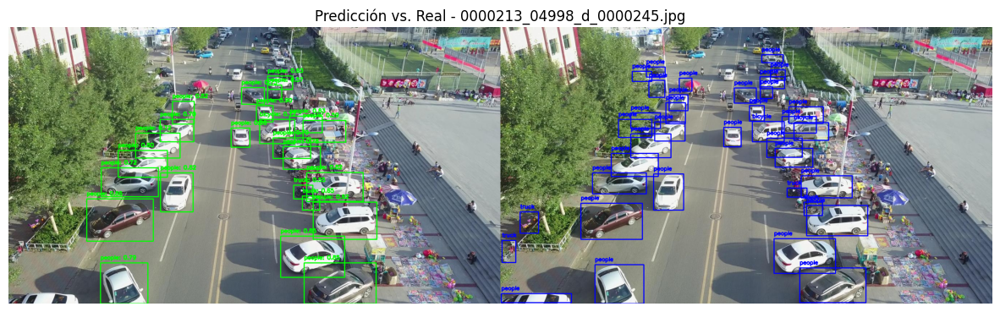


image 1/1 /content/VisDrone-AreaFilter-val/images/0000312_01001_d_0000419.jpg: 640x1088 1 pedestrian, 38 cars, 1 van, 1 motor, 33.9ms
Speed: 7.6ms preprocess, 33.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 1088)


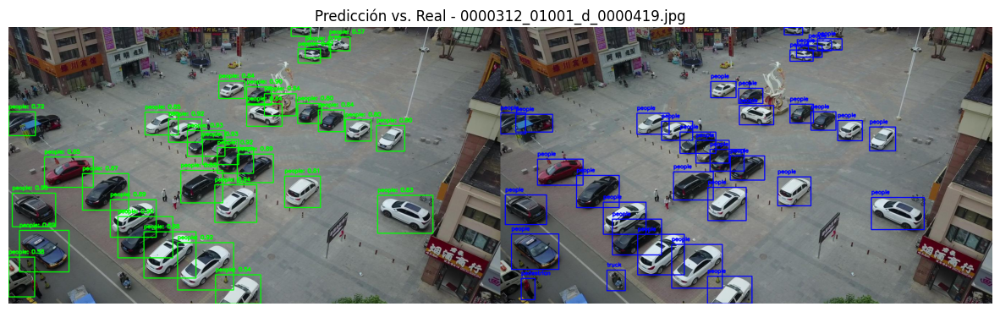


image 1/1 /content/VisDrone-AreaFilter-val/images/0000001_07999_d_0000012.jpg: 640x1088 1 pedestrian, 6 cars, 1 motor, 33.9ms
Speed: 7.7ms preprocess, 33.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 1088)


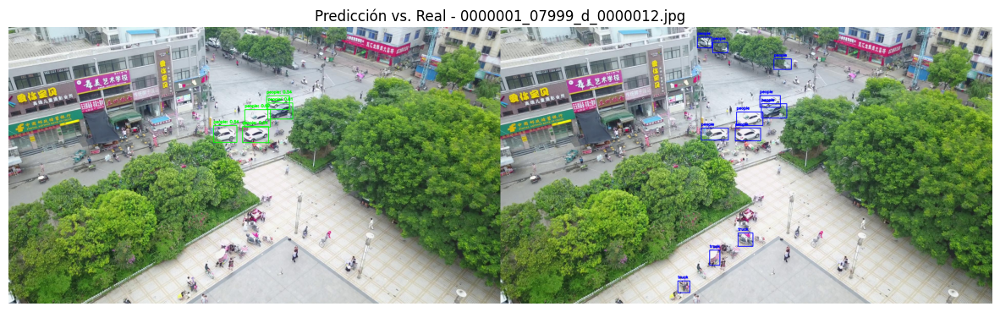


image 1/1 /content/VisDrone-AreaFilter-val/images/0000271_05401_d_0000399.jpg: 640x1088 18 cars, 2 vans, 1 truck, 54.6ms
Speed: 12.9ms preprocess, 54.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 1088)


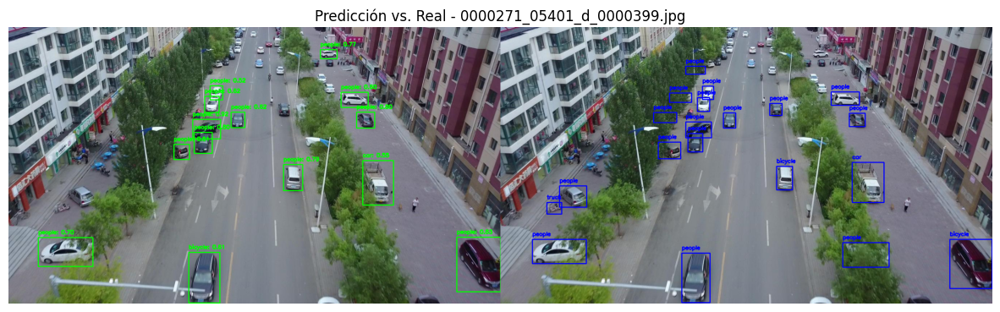


image 1/1 /content/VisDrone-AreaFilter-val/images/0000360_00197_d_0000714.jpg: 640x1088 20 cars, 1 truck, 1 motor, 54.6ms
Speed: 7.9ms preprocess, 54.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 1088)


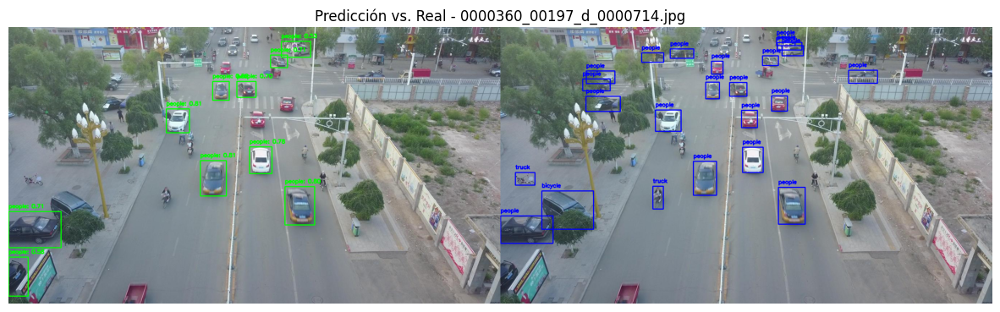


image 1/1 /content/VisDrone-AreaFilter-val/images/0000335_02745_d_0000057.jpg: 640x1088 1 pedestrian, 14 cars, 5 motors, 54.7ms
Speed: 6.9ms preprocess, 54.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 1088)


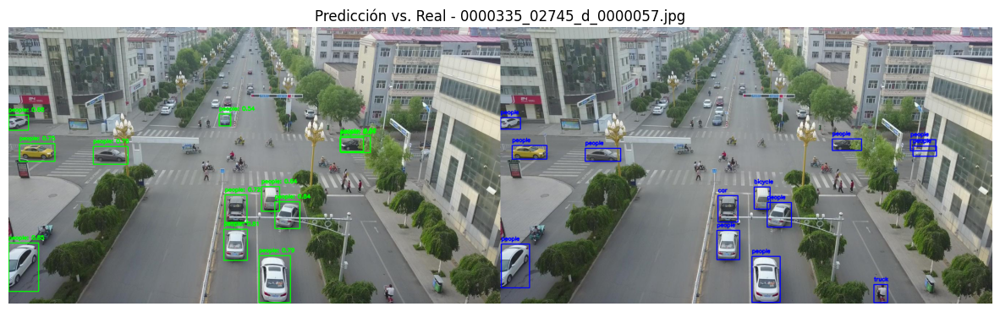


image 1/1 /content/VisDrone-AreaFilter-val/images/0000277_01401_d_0000546.jpg: 640x1088 5 pedestrians, 21 cars, 2 vans, 1 truck, 1 bus, 1 motor, 54.6ms
Speed: 6.7ms preprocess, 54.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 1088)


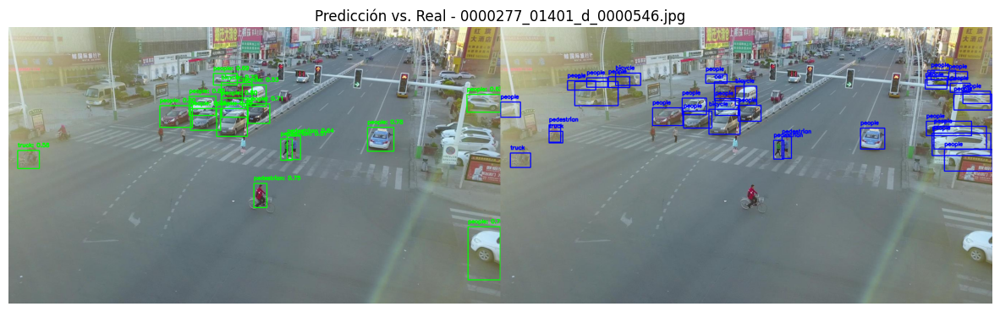


image 1/1 /content/VisDrone-AreaFilter-val/images/0000242_00963_d_0000005.jpg: 640x1088 1 pedestrian, 8 cars, 1 van, 54.5ms
Speed: 6.2ms preprocess, 54.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 1088)


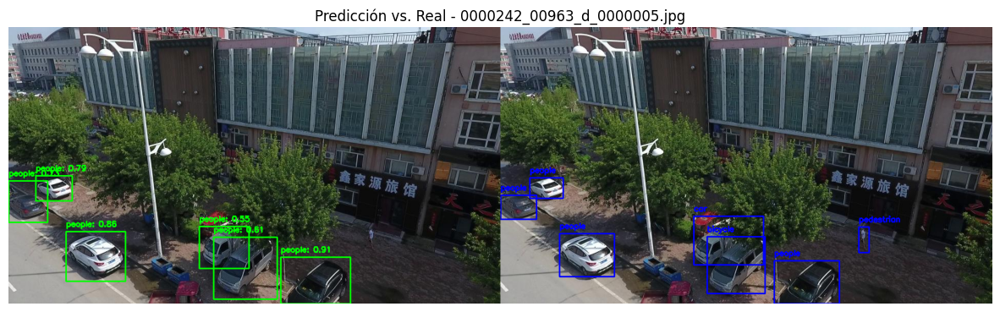


image 1/1 /content/VisDrone-AreaFilter-val/images/0000193_01497_d_0000111.jpg: 640x1088 1 pedestrian, 10 cars, 2 trucks, 8 motors, 54.6ms
Speed: 6.7ms preprocess, 54.6ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 1088)


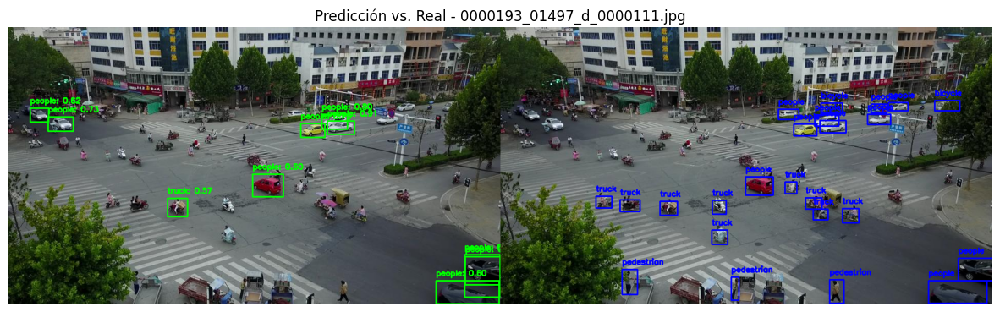


image 1/1 /content/VisDrone-AreaFilter-val/images/0000295_02900_d_0000034.jpg: 640x1088 5 pedestrians, 26 cars, 4 buss, 2 motors, 54.5ms
Speed: 11.8ms preprocess, 54.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 1088)


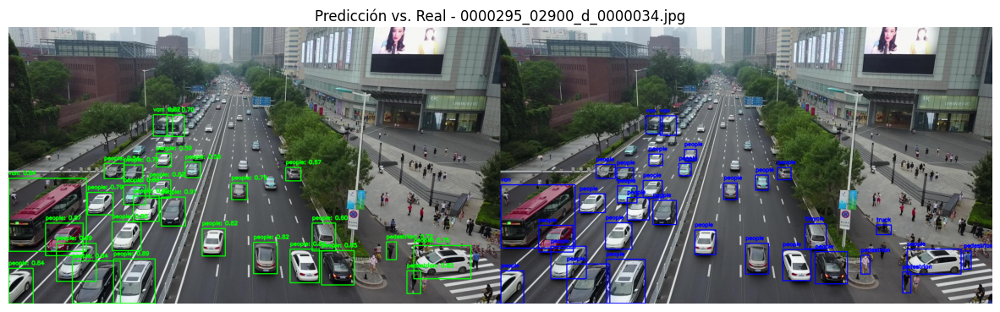

In [107]:
# Ejemplos en validación
image_files_to_predict = random.sample(os.listdir(images_dir_val), 10)

# Realizar predicciones y mostrar las imágenes con las bounding boxes
predict_and_show_images_comparison(image_files_to_predict, model_3, images_dir_val, labels_dir_val, df)

In [108]:
# Save the model to a file (e.g., 'best.pt')
model_3.save('model_3.pt')

# Download the saved model to your local machine
files.download('model_3.pt')

NameError: name 'files' is not defined

# Tuneo de Hiperparámetros

In [109]:
%%python --version

Python 3.10.12


In [110]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

!pip install ray

In [111]:
from ray import tune

## Hiperparámetros de augmentation

In [ ]:
# Define the hyperparameter search space for scenario 1
scenario1_space = {
    "crop_fraction": tune.uniform(0.1, 1.0),
    "auto_augment": tune.choice(["randaugment", None]),  # Use None to disable
    "mosaic": tune.uniform(0.0, 1.0),
    "hsv_v": tune.uniform(0.0, 1.0),
    "hsv_s": tune.uniform(0.0, 1.0),
    "hsv_h": tune.uniform(0.0, 1.0),
}

# Define a function to train and evaluate the model with given hyperparameters
def train_and_evaluate(config):
    model = YOLO("yolov8m.pt")  # Load your model

    # Update training settings based on config
    model.train(data="/content/data.yaml",
                #imgsz=1080,
                batch=16,
                epochs=20,
                freeze=16,
                **config)

    # Evaluate the model
    metrics = model.val()
    return {"mAP50-95": metrics.box.map}  # Use your desired metric

# Start the hyperparameter search for scenario 1
analysis = tune.run(
    train_and_evaluate,
    config=scenario1_space,
    num_samples=10,  # Number of trials
    resources_per_trial={"cpu": 2, "gpu": 1},
)

# Print the best hyperparameters and results
best_config_1 = analysis.get_best_config(metric="mAP50-95", mode="max")
print(f"Best hyperparameters for Scenario 1: {best_config_1}")
#print(f"Best mAP50-95: {analysis.get_best_trial(metric='mAP50-95', mode='max').best_result['mAP50-95']}")
print(f"Best mAP50-95: {analysis.get_best_trial(metric='mAP50-95', mode='max').last_result['mAP50-95']}")

2024-10-03 22:49:56,946	WARNING callback.py:136 -- The TensorboardX logger cannot be instantiated because either TensorboardX or one of it's dependencies is not installed. Please make sure you have the latest version of TensorboardX installed: `pip install -U tensorboardx`


+---------------------------------------------------------------------------+
| Configuration for experiment     train_and_evaluate_2024-10-03_22-49-56   |
+---------------------------------------------------------------------------+
| Search algorithm                 BasicVariantGenerator                    |
| Scheduler                        FIFOScheduler                            |
| Number of trials                 10                                       |
+---------------------------------------------------------------------------+

View detailed results here: /root/ray_results/train_and_evaluate_2024-10-03_22-49-56

Trial status: 10 PENDING
Current time: 2024-10-03 22:49:57. Total running time: 0s
Logical resource usage: 0/2 CPUs, 0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------+
| Trial name                       status       crop_fraction   auto_augment       mo

  0%|          | 0.00/49.7M [00:00<?, ?B/s]
 12%|█▏        | 6.12M/49.7M [00:00<00:00, 60.0MB/s]
 40%|████      | 20.1M/49.7M [00:00<00:00, 101MB/s] 
 67%|██████▋   | 33.2M/49.7M [00:00<00:00, 116MB/s]
100%|██████████| 49.7M/49.7M [00:00<00:00, 120MB/s]


(train_and_evaluate pid=20805) Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
(train_and_evaluate pid=20805) engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=16, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=

100%|██████████| 5.35M/5.35M [00:00<00:00, 75.4MB/s]
train: Scanning /content/VisDrone-AreaFilter-train/labels.cache... 480 images, 22 backgrounds, 0 corrupt: 100%|██████████| 500/500 [00:00<?, ?it/s]


(train_and_evaluate pid=20805) AMP: checks passed ✅


(train_and_evaluate pid=20805) /usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.17 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
(train_and_evaluate pid=20805)   check_for_updates()
(train_and_evaluate pid=20805) /usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
(train_and_evaluate pid=20805)   self.pid = os.fork()


(train_and_evaluate pid=20805) albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/VisDrone-AreaFilter-val/labels.cache... 50 images, 0 backgrounds, 0 corrupt: 100%|██████████| 50/50 [00:00<?, ?it/s]



Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-03 22:50:57. Total running time: 1min 0s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------+
| Trial name                       status       crop_fraction   auto_augment       mosaic      hsv_v      hsv_s       hsv_h |
+---------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_d0020_00000   RUNNING           0.593932                    0.844266   0.857946   0.847252   0.623564  |
| train_and_evaluate_d0020_00001   PENDING           0.445944                    0.891773   0.963663   0.383442   0.791725  |
| train_and_evaluate_d0020_00002   PENDING           0.576005   randaugment      0.392785   0.836079   0.337396   0.648172  |
| train_and_evaluate_d0020_00003   PENDING           0.431417      

  0%|          | 0/32 [00:00<?, ?it/s]


(train_and_evaluate pid=20805) TensorBoard: model graph visualization added ✅
(train_and_evaluate pid=20805) Image sizes 640 train, 640 val
(train_and_evaluate pid=20805) Using 2 dataloader workers
(train_and_evaluate pid=20805) Logging results to runs/detect/train
(train_and_evaluate pid=20805) Starting training for 20 epochs...
(train_and_evaluate pid=20805) 
(train_and_evaluate pid=20805)       Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      2.02G      1.695      4.294       1.23        292        640:   3%|▎         | 1/32 [00:02<01:18,  2.53s/it]
       1/20       2.1G      1.545       4.24      1.175        212        640:   6%|▋         | 2/32 [00:02<00:38,  1.27s/it]
       1/20      2.34G      1.601       4.24      1.185        473        640:   6%|▋         | 2/32 [00:04<00:38,  1.27s/it]
       1/20      2.34G      1.601       4.24      1.185        473        640:   9%|▉         | 3/32 [00:04<00:42,  1.45s/it]
       1/20      2.34G      1.511      4.218      1.147        351        640:  12%|█▎        | 4/32 [00:05<00:33,  1.19s/it]
       1/20      2.34G      1.479       4.21      1.123        231        640:  16%|█▌        | 5/32 [00:07<00:38,  1.44s/it]
       1/20      2.55G      1.451      4.215      1.116        441        640:  19%|█▉        | 6/32 [00:07<00:27,  1.07s/it]
       1/20      2.55G      1.439      4.214      1.112        367        640:  22%|██▏       | 7/32 [00:08<00:21,  1.

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-03 22:51:27. Total running time: 1min 30s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------+
| Trial name                       status       crop_fraction   auto_augment       mosaic      hsv_v      hsv_s       hsv_h |
+---------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_d0020_00000   RUNNING           0.593932                    0.844266   0.857946   0.847252   0.623564  |
| train_and_evaluate_d0020_00001   PENDING           0.445944                    0.891773   0.963663   0.383442   0.791725  |
| train_and_evaluate_d0020_00002   PENDING           0.576005   randaugment      0.392785   0.836079   0.337396   0.648172  |
| train_and_evaluate_d0020_00003   PENDING           0.431417      

       1/20      2.55G      1.493      3.813      1.104        231        640:  75%|███████▌  | 24/32 [00:17<00:03,  2.21it/s]
       1/20      2.55G        1.5      3.774      1.106        358        640:  78%|███████▊  | 25/32 [00:17<00:02,  2.35it/s]
       1/20      2.55G      1.498      3.743      1.105        370        640:  81%|████████▏ | 26/32 [00:18<00:02,  2.22it/s]
       1/20      2.55G      1.501       3.72      1.106        348        640:  84%|████████▍ | 27/32 [00:18<00:02,  2.32it/s]
       1/20      2.55G      1.493      3.685      1.102        420        640:  88%|████████▊ | 28/32 [00:19<00:01,  2.26it/s]
       1/20      2.55G      1.495      3.654      1.101        302        640:  91%|█████████ | 29/32 [00:19<00:01,  2.43it/s]
       1/20      2.55G      1.493      3.624      1.099        296        640:  94%|█████████▍| 30/32 [00:20<00:00,  2.32it/s]
       1/20      2.55G      1.501      3.602      1.099        350        640:  97%|█████████▋| 31/32 [00:20<00

(train_and_evaluate pid=20805)                    all         50       1016    0.00906      0.107     0.0107    0.00576

Trial train_and_evaluate_d0020_00000 finished iteration 1 at 2024-10-03 22:51:33. Total running time: 1min 36s
+---------------------------------------------------------+
| Trial train_and_evaluate_d0020_00000 result             |
+---------------------------------------------------------+
| checkpoint_dir_name                                     |
| time_this_iter_s                                61.8205 |
| time_total_s                                    61.8205 |
| training_iteration                                    1 |
| epoch                                                 0 |
| metrics/mAP50(B)                                0.01066 |
| metrics/mAP50-95(B)                             0.00576 |
| metrics/precision(B)                            0.00906 |
| metrics/recall(B)                               0.10719 |
| val/box_loss                                  

  0%|          | 0/32 [00:00<?, ?it/s]


(train_and_evaluate pid=20805) 
(train_and_evaluate pid=20805)       Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      2.23G      1.596      2.747      1.099        448        640:   3%|▎         | 1/32 [00:00<00:16,  1.86it/s]
       2/20      2.23G      1.527       2.68      1.084        290        640:   6%|▋         | 2/32 [00:00<00:11,  2.57it/s]
       2/20      2.39G       1.48      2.666       1.09        303        640:   9%|▉         | 3/32 [00:01<00:11,  2.44it/s]
       2/20      2.39G       1.47      2.662      1.079        439        640:  12%|█▎        | 4/32 [00:01<00:11,  2.54it/s]
       2/20      2.39G       1.52      2.682      1.082        355        640:  16%|█▌        | 5/32 [00:02<00:11,  2.45it/s]
       2/20      2.39G      1.494      2.659       1.07        284        640:  19%|█▉        | 6/32 [00:02<00:09,  2.65it/s]
       2/20      2.39G      1.495      2.636      1.081        278        640:  22%|██▏       | 7/32 [00:02<00:09,  2.51it/s]
       2/20      2.39G      1.515      2.621      1.083        443        640:  25%|██▌       | 8/32 [00:03<00:09,  2.

(train_and_evaluate pid=20805)                    all         50       1016     0.0201      0.143     0.0292     0.0185

Trial train_and_evaluate_d0020_00000 finished iteration 2 at 2024-10-03 22:51:51. Total running time: 1min 54s
+---------------------------------------------------------+
| Trial train_and_evaluate_d0020_00000 result             |
+---------------------------------------------------------+
| checkpoint_dir_name                                     |
| time_this_iter_s                                17.9384 |
| time_total_s                                    79.7589 |
| training_iteration                                    2 |
| epoch                                                 1 |
| metrics/mAP50(B)                                0.02924 |
| metrics/mAP50-95(B)                             0.01854 |
| metrics/precision(B)                            0.02007 |
| metrics/recall(B)                               0.14289 |
| val/box_loss                                  

  0%|          | 0/32 [00:00<?, ?it/s]


(train_and_evaluate pid=20805) 
(train_and_evaluate pid=20805)       Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      2.08G      1.472      2.212      1.106        387        640:   3%|▎         | 1/32 [00:00<00:07,  3.95it/s]
       3/20      2.19G      1.487      2.196      1.111        325        640:   6%|▋         | 2/32 [00:00<00:12,  2.44it/s]
       3/20      2.19G      1.487      2.147      1.093        379        640:   9%|▉         | 3/32 [00:01<00:09,  2.97it/s]
       3/20      2.19G       1.46      2.122       1.08        300        640:  12%|█▎        | 4/32 [00:01<00:08,  3.20it/s]
       3/20      2.19G      1.457      2.129      1.079        314        640:  16%|█▌        | 5/32 [00:01<00:08,  3.20it/s]
       3/20      2.39G      1.487      2.145      1.077        732        640:  19%|█▉        | 6/32 [00:01<00:07,  3.36it/s]
       3/20      2.39G       1.48      2.127      1.075        401        640:  22%|██▏       | 7/32 [00:02<00:07,  3.41it/s]
       3/20      2.39G      1.481      2.132      1.068        375        640:  25%|██▌       | 8/32 [00:02<00:07,  3.


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-03 22:51:57. Total running time: 2min 0s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                       status       crop_fraction   auto_augment       mosaic      hsv_v      hsv_s       hsv_h     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_d0020_00000   RUNNING           0.593932                    0.84

       3/20      2.65G      1.514      2.142      1.063        303        640:  47%|████▋     | 15/32 [00:05<00:09,  1.80it/s]
       3/20      2.65G      1.513      2.144      1.062        462        640:  50%|█████     | 16/32 [00:06<00:07,  2.06it/s]
       3/20      2.65G      1.512      2.145      1.062        402        640:  53%|█████▎    | 17/32 [00:06<00:07,  1.90it/s]
       3/20      2.65G      1.526      2.156      1.062        401        640:  56%|█████▋    | 18/32 [00:07<00:07,  1.90it/s]
       3/20      2.65G      1.526      2.154       1.06        458        640:  59%|█████▉    | 19/32 [00:07<00:06,  1.94it/s]
       3/20      2.65G      1.519      2.153      1.059        232        640:  62%|██████▎   | 20/32 [00:08<00:06,  1.73it/s]
       3/20      2.65G      1.515      2.148       1.06        385        640:  66%|██████▌   | 21/32 [00:08<00:05,  1.99it/s]
       3/20      2.65G      1.513      2.142       1.06        294        640:  69%|██████▉   | 22/32 [00:09<00

(train_and_evaluate pid=20805)                    all         50       1016     0.0264      0.504      0.155     0.0905

Trial train_and_evaluate_d0020_00000 finished iteration 3 at 2024-10-03 22:52:11. Total running time: 2min 14s
+---------------------------------------------------------+
| Trial train_and_evaluate_d0020_00000 result             |
+---------------------------------------------------------+
| checkpoint_dir_name                                     |
| time_this_iter_s                                20.0603 |
| time_total_s                                    99.8192 |
| training_iteration                                    3 |
| epoch                                                 2 |
| metrics/mAP50(B)                                0.15505 |
| metrics/mAP50-95(B)                             0.09051 |
| metrics/precision(B)                            0.02641 |
| metrics/recall(B)                                0.5039 |
| val/box_loss                                  

  0%|          | 0/32 [00:00<?, ?it/s]


(train_and_evaluate pid=20805) 
(train_and_evaluate pid=20805)       Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      2.03G      1.635      2.156      1.133        291        640:   3%|▎         | 1/32 [00:00<00:09,  3.43it/s]
       4/20      2.26G      1.638      2.265      1.131        271        640:   6%|▋         | 2/32 [00:00<00:08,  3.48it/s]
       4/20      2.26G      1.685      2.307      1.129        349        640:   9%|▉         | 3/32 [00:00<00:08,  3.62it/s]
       4/20      2.26G      1.673      2.309      1.118        307        640:  12%|█▎        | 4/32 [00:01<00:08,  3.26it/s]
       4/20      2.26G      1.615      2.239      1.109        291        640:  16%|█▌        | 5/32 [00:01<00:07,  3.44it/s]
       4/20      2.26G      1.578      2.204      1.097        287        640:  19%|█▉        | 6/32 [00:01<00:07,  3.62it/s]
       4/20      2.26G      1.561      2.185      1.089        444        640:  22%|██▏       | 7/32 [00:01<00:06,  3.67it/s]
       4/20      2.26G      1.561      2.192      1.086        360        640:  25%|██▌       | 8/32 [00:02<00:07,  3.


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-03 22:52:27. Total running time: 2min 30s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                       status       crop_fraction   auto_augment       mosaic      hsv_v      hsv_s       hsv_h     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_d0020_00000   RUNNING           0.593932                    0.8

       4/20      2.63G       1.52      2.018      1.067        419        640:  97%|█████████▋| 31/32 [00:15<00:00,  1.90it/s]
       4/20      2.64G      1.522      2.019      1.067         77        640: 100%|██████████| 32/32 [00:15<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/2 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 1/2 [00:00<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.23it/s]


(train_and_evaluate pid=20805)                    all         50       1016      0.549      0.163      0.242      0.153

Trial train_and_evaluate_d0020_00000 finished iteration 4 at 2024-10-03 22:52:31. Total running time: 2min 35s
+---------------------------------------------------------+
| Trial train_and_evaluate_d0020_00000 result             |
+---------------------------------------------------------+
| checkpoint_dir_name                                     |
| time_this_iter_s                                20.2924 |
| time_total_s                                    120.112 |
| training_iteration                                    4 |
| epoch                                                 3 |
| metrics/mAP50(B)                                0.24179 |
| metrics/mAP50-95(B)                             0.15292 |
| metrics/precision(B)                             0.5492 |
| metrics/recall(B)                               0.16287 |
| val/box_loss                                  

  0%|          | 0/32 [00:00<?, ?it/s]


(train_and_evaluate pid=20805) 
(train_and_evaluate pid=20805)       Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20      2.12G      1.443      1.824       1.05        372        640:   3%|▎         | 1/32 [00:00<00:09,  3.16it/s]
       5/20      2.36G      1.504      1.876       1.06        375        640:   6%|▋         | 2/32 [00:00<00:08,  3.50it/s]
       5/20      2.36G      1.453      1.855      1.047        346        640:   9%|▉         | 3/32 [00:00<00:08,  3.49it/s]
       5/20      2.55G      1.446       1.84      1.039        369        640:  12%|█▎        | 4/32 [00:01<00:08,  3.15it/s]
       5/20      2.55G      1.456      1.837      1.034        429        640:  16%|█▌        | 5/32 [00:01<00:08,  3.32it/s]
       5/20      2.55G      1.466      1.877      1.048        293        640:  19%|█▉        | 6/32 [00:01<00:07,  3.51it/s]
       5/20      2.55G      1.487      1.896      1.056        317        640:  22%|██▏       | 7/32 [00:02<00:06,  3.63it/s]
       5/20      2.55G      1.477      1.886      1.054        240        640:  25%|██▌       | 8/32 [00:02<00:06,  3.

(train_and_evaluate pid=20805)                    all         50       1016       0.41      0.328      0.303      0.193

Trial train_and_evaluate_d0020_00000 finished iteration 5 at 2024-10-03 22:52:50. Total running time: 2min 53s
+---------------------------------------------------------+
| Trial train_and_evaluate_d0020_00000 result             |
+---------------------------------------------------------+
| checkpoint_dir_name                                     |
| time_this_iter_s                                18.2942 |
| time_total_s                                    138.406 |
| training_iteration                                    5 |
| epoch                                                 4 |
| metrics/mAP50(B)                                0.30258 |
| metrics/mAP50-95(B)                             0.19317 |
| metrics/precision(B)                            0.40964 |
| metrics/recall(B)                               0.32758 |
| val/box_loss                                  

  0%|          | 0/32 [00:00<?, ?it/s]


(train_and_evaluate pid=20805) 
(train_and_evaluate pid=20805)       Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20         2G      1.197      1.898     0.9578        247        640:   3%|▎         | 1/32 [00:00<00:08,  3.50it/s]
       6/20      2.23G      1.376      1.899      1.017        457        640:   6%|▋         | 2/32 [00:00<00:08,  3.56it/s]
       6/20      2.23G      1.414       1.93      1.065        245        640:   9%|▉         | 3/32 [00:00<00:07,  3.68it/s]
       6/20      2.23G      1.392      1.877      1.057        354        640:  12%|█▎        | 4/32 [00:01<00:10,  2.66it/s]
       6/20      2.23G      1.368      1.871      1.049        344        640:  16%|█▌        | 5/32 [00:01<00:09,  2.85it/s]
       6/20      2.42G      1.377      1.863      1.044        402        640:  19%|█▉        | 6/32 [00:02<00:16,  1.57it/s]
       6/20      2.42G      1.395      1.869      1.045        326        640:  22%|██▏       | 7/32 [00:03<00:16,  1.56it/s]
       6/20      2.42G      1.422      1.879      1.046        451        640:  25%|██▌       | 8/32 [00:06<00:32,  1.


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-03 22:52:57. Total running time: 3min 0s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                       status       crop_fraction   auto_augment       mosaic      hsv_v      hsv_s       hsv_h     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_d0020_00000   RUNNING           0.593932                    0.84

       6/20      2.42G      1.442      1.876      1.042        345        640:  28%|██▊       | 9/32 [00:07<00:29,  1.26s/it]
       6/20      2.42G      1.442      1.862      1.044        427        640:  31%|███▏      | 10/32 [00:08<00:26,  1.21s/it]
       6/20      2.42G       1.44      1.863      1.039        338        640:  34%|███▍      | 11/32 [00:09<00:26,  1.27s/it]
       6/20      2.42G      1.436      1.849       1.04        461        640:  38%|███▊      | 12/32 [00:15<00:51,  2.57s/it]
       6/20      2.42G      1.424      1.844      1.034        258        640:  41%|████      | 13/32 [00:17<00:46,  2.45s/it]
       6/20      2.42G      1.419      1.843      1.031        349        640:  44%|████▍     | 14/32 [00:18<00:34,  1.90s/it]
       6/20      2.42G      1.417       1.83       1.03        405        640:  47%|████▋     | 15/32 [00:21<00:37,  2.20s/it]


In [ ]:
# Eliminar esta celda porque ya se calcula en la anterior
print(f"Best mAP50-95: {analysis.get_best_trial(metric='mAP50-95', mode='max').last_result['mAP50-95']}")

- Diccionario de parametros actualizado:

In [ ]:
# Mejores parámetros

best_trial = analysis.get_best_trial(metric="mAP50-95", mode="max")
best_parameters = best_trial.config

print(best_parameters)


In [ ]:
# Define the variation percentage
variation_percentage = 0.05  # 5% variation

# Create a new configuration dictionary with variations
config_with_variations_1 = {}
for param_name, best_value in best_config_1.items():
    if param_name in scenario1_space:
        # For Float or continuous parameters defined by tune.uniform
        if isinstance(best_value, float):  # If the best value is a float, assume it's from tune.uniform
            lower_bound = best_value * (1 - variation_percentage)
            upper_bound = best_value * (1 + variation_percentage)
            config_with_variations_1[param_name] = tune.uniform(lower_bound, upper_bound)
        # For Categorical parameters defined by tune.choice
        elif isinstance(best_value, str) or isinstance(best_value, int):  # For categorical values (str or int)
            config_with_variations_1[param_name] = scenario1_space[param_name]  # Keep the same choices

print("Configuration with variations:")
print(config_with_variations_1)


## Hiperparámetros de configuracion del entrenamiento

In [ ]:
scenario2_space = {
    "imgsz": tune.choice([640, 920, 1080]),  # Randomly choose between two sizes
    "pretrained": tune.choice([True, False]),
    "lr0": tune.loguniform(1e-4, 1e-2), # Randomly sample from a log-uniform distribution between 1e-4 and 1e-2
    "momentum": tune.uniform(0.8, 0.99),  # Default 0.937
    "weight_decay": tune.loguniform(1e-5, 1e-3), # Default 0.0005
    "warmup_bias_lr": tune.uniform(0.05, 0.2),   # Default 0.1
    "kobj": tune.uniform(1.0, 3.0),  # Default 2.0
    "dropout": tune.uniform(0.0, 0.6),
}

In [ ]:
# Start the hyperparameter search for scenario 1
analysis = tune.run(
    train_and_evaluate,
    config=scenario2_space,
    num_samples=10,  # Number of trials
    resources_per_trial={"cpu": 2, "gpu": 1},
)

# Print the best hyperparameters and results
best_config_2 = analysis.get_best_config(metric="mAP50-95", mode="max")
print(f"Best hyperparameters for Scenario 1: {best_config_2}")
#print(f"Best mAP50-95: {analysis.get_best_trial().best_result['mAP50-95']}")
print(f"Best mAP50-95: {analysis.get_best_trial(metric='mAP50-95', mode='max').last_result['mAP50-95']}")

In [ ]:
print(f"Best mAP50-95: {analysis.get_best_trial(metric='mAP50-95', mode='max').last_result['mAP50-95']}")

## Tuneo conjunto
- Utilizando los mejores parámetros de cada escenario.

In [ ]:
# Combinar los dos diccionarios de configuración
combined_config = {**config_with_variations_1, **best_config_2} # ** se usa para desempaquetar los diccionarios y combinarlos en uno solo.
combined_config["plots"]='True' # to save plots in "runs" folder

# Iniciar la búsqueda de hiperparámetros con la configuración combinada
analysis = tune.run(
    train_and_evaluate,
    config=combined_config,
    num_samples=10,  # Número de pruebas
    resources_per_trial={"cpu": 2, "gpu": 1},
)

In [ ]:
# Print the best hyperparameters and results
best_trial = analysis.get_best_trial(metric="mAP50-95", mode="max")
final_config = best_trial.config
print(f"Best hyperparameters: {final_config}")
print(f"Best mAP50-95: {best_trial.best_result['mAP50-95']}")

# Get the checkpoint directory of the best trial
best_checkpoint_dir = best_trial.checkpoint.value

# Load the model from the checkpoint
best_model = YOLO(best_checkpoint_dir)

In [ ]:
from google.colab import files

# Save the model
best_model.save(save_dir='best_model.pt')
# Download the saved model to your local machine
files.download('best_model.pt')

---

# Imprementacion de otros Backbones

## Florence-2

In [ ]:
!pip install transformers==4.31.0 accelerate datasets
!pip install --upgrade huggingface_hub

In [ ]:
from transformers import AutoImageProcessor, AutoModelForObjectDetection
from transformers import TrainingArguments, Trainer

import torch

In [ ]:
# Load the image processor and model
image_processor = AutoImageProcessor.from_pretrained("microsoft/Florence-2-large")
model = AutoModelForObjectDetection.from_pretrained("microsoft/Florence-2-large")

# Define the training arguments
training_args = TrainingArguments(
    output_dir="./results",
    per_device_train_batch_size=8,
    per_device_eval_batch_size=8,
    num_train_epochs=3,
    fp16=True,  # Enable mixed precision training
    save_steps=100,  # Save checkpoint every 100 steps
    eval_steps=100,  # Evaluate every 100 steps
    logging_dir="./logs",
    learning_rate=2e-5,
    weight_decay=0.01,
    remove_unused_columns=False,
    #load_best_model_at_end=True,
    push_to_hub=False,  # Set to True to push to Hugging Face Hub
    #hub_model_id="your_username/your_model_name",
    #hub_token="your_hub_token",
)

# Define the trainer
trainer = Trainer(
    model=model,
    args=training_args,
    #train_dataset=train_dataset,  # Your training dataset
    #eval_dataset=val_dataset,    # Your validation dataset
    #data_collator=collate_fn,     # Custom data collator if needed
)

# Start training
train_results = trainer.train()

# Save the trained model
trainer.save_model("./florence-2-visdrone")

## RetinaNet